In [ ]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()


In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

solesensei_solesensei_bdd100k_path = kagglehub.dataset_download('solesensei/solesensei_bdd100k')
medoarafa_mywork_path = kagglehub.dataset_download('medoarafa/mywork')

print('Data source import complete.')


In [ ]:
print("medo")

medo


# Section 1: Setup and Environment Configuration

## 1.1 Introduction and Objectives

This notebook tackles the challenge of **Real-Time Object Detection for Autonomous Vehicles**. Our goal is to develop and evaluate a robust object detection model, specifically focusing on:

1.  **Critical Object Classes:** Precisely detecting vehicles, pedestrians, and crucial traffic signs vital for safe navigation.
2.  **Challenging Conditions:** Enhancing model robustness against variations simulated through advanced data augmentation (weather, lighting, occlusions).
3.  **State-of-the-Art Modeling:** Utilizing and fine-tuning a YOLOv8 (or potentially YOLOv9) model, leveraging transfer learning.
4.  **Rigorous Evaluation:** Going beyond basic mAP to include class-wise performance analysis, error analysis, and inference speed checks.
5.  **MLOps Best Practices:** Incorporating experiment tracking (Weights & Biases) and model versioning concepts within the Kaggle environment.

We will use the **BDD100K (Berkeley DeepDrive)** dataset, a comprehensive resource for autonomous driving research available on Kaggle.

**Core Libraries:** PyTorch, Ultralytics YOLO, Albumentations, Pandas, OpenCV, Matplotlib, Seaborn, Weights & Biases, Gradio.

In [ ]:
# 1.2 Library Imports

# Core Libraries
import os
import gc  # Garbage collection
import sys
import yaml # For reading YAML configuration files (like dataset configs)
import glob # For finding file paths matching a pattern
import shutil # For file operations (like copying)
import warnings # To control warning messages
import random
from pathlib import Path # Object-oriented filesystem paths
import subprocess # For running shell commands if needed (like pip install)

# Data Handling
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None) # Show all columns in DataFrames
pd.set_option('display.max_rows', 100)     # Show more rows

# Visualization
import cv2 # OpenCV for image manipulation
from PIL import Image # Pillow for image manipulation
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn-v0_8-whitegrid') # Set a clean plot style
# %matplotlib inline # Ensure plots appear in the notebook

# Machine Learning / Deep Learning
import torch
# Need to install ultralytics if not available in the Kaggle environment
try:
    import ultralytics
    from ultralytics import YOLO
    print(f"Ultralytics Version: {ultralytics.__version__}")
except ImportError:
    print("Ultralytics not found. Installing...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "ultralytics"])
    import ultralytics
    from ultralytics import YOLO
    print(f"Ultralytics Version: {ultralytics.__version__}")

# Augmentations (Install if needed)
try:
    import albumentations as A
    print(f"Albumentations Version: {A.__version__}")
except ImportError:
    print("Albumentations not found. Installing...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "albumentations>=1.1.0"]) # Ensure a recent version
    import albumentations as A
    print(f"Albumentations Version: {A.__version__}")

# Experiment Tracking (Install if needed)
try:
    import wandb
    print(f"Weights & Biases Version: {wandb.__version__}")
except ImportError:
    print("Weights & Biases not found. Installing...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "wandb"])
    import wandb
    print(f"Weights & Biases Version: {wandb.__version__}")

# Deployment Simulation (Install if needed)
try:
    import gradio as gr
    print(f"Gradio Version: {gr.__version__}")
except ImportError:
    print("Gradio not found. Installing...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "gradio"])
    import gradio as gr
    print(f"Gradio Version: {gr.__version__}")

# Utilities
from tqdm.notebook import tqdm # Progress bars
from kaggle_secrets import UserSecretsClient # To access Kaggle secrets (like W&B API key)

# Environment settings
warnings.filterwarnings('ignore') # Suppress warnings for cleaner output
os.environ['WANDB_DISABLED'] = 'true' # Initially disable W&B, enable later if login succeeds

Ultralytics Version: 8.3.120


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.6' (you have '2.0.4'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


Albumentations Version: 2.0.4
Weights & Biases Version: 0.19.6
Gradio Version: 5.27.1


## 1.3 Configuration Settings

Centralizing configuration is crucial for reproducibility and clarity. We define paths, model parameters, hyperparameters, and project settings here.

*   **Dataset Paths:** Pointing to the BDD100K dataset files within the Kaggle input directory. We need paths for images and the JSON annotation files.
*   **Model Config:** Specifying the YOLO model architecture and input image size.
*   **Training Hyperparameters:** Defining batch size, epochs, optimizer settings, learning rates, etc. These may be tuned later.
*   **Output Config:** Setting up directories for saving results, models, and logs.
*   **Project Config:** Naming the project and setting a random seed for reproducibility.

In [ ]:
# 1.3 Configuration Settings Definition

class CFG:
    # --- Dataset Paths ---
    # Adjust these paths based on the exact structure within /kaggle/input/solesensei_bdd100k/
    # It seems the dataset might have nested 'bdd100k' directories, verify carefully.
    DATASET_BASE_PATH = "/kaggle/input/solesensei_bdd100k/"
    # Assuming images are under bdd100k/bdd100k/images/100k/
    IMAGE_PATH = os.path.join(DATASET_BASE_PATH, 'bdd100k/bdd100k/images/100k')
    # Assuming labels are under bdd100k_labels_release/bdd100k/labels/
    LABEL_PATH = os.path.join(DATASET_BASE_PATH, 'bdd100k_labels_release/bdd100k/labels')

    TRAIN_IMAGE_DIR = os.path.join(IMAGE_PATH, 'train')
    VAL_IMAGE_DIR = os.path.join(IMAGE_PATH, 'val')
    TEST_IMAGE_DIR = os.path.join(IMAGE_PATH, 'test') # If using test set

    TRAIN_JSON_PATH = os.path.join(LABEL_PATH, 'bdd100k_labels_images_train.json')
    VAL_JSON_PATH = os.path.join(LABEL_PATH, 'bdd100k_labels_images_val.json')
    # Note: BDD100K test set labels are typically hidden for challenges. We might create our own test split from val.

    # --- Model Config ---
    MODEL_NAME = 'yolov8m.pt' # Medium model - good balance of speed and accuracy. Alternatives: yolov8n.pt, yolov8s.pt, yolov8l.pt, yolov8x.pt
    IMG_SIZE = 640           # Standard input size for many YOLOv8 models

    # --- Training Hyperparameters ---
    BATCH_SIZE = 1          # Adjust based on Kaggle GPU Memory (T4=16GB, P100=16GB)
    EPOCHS = 5              # Initial number of epochs, can be adjusted with early stopping
    LEARNING_RATE = 1e-3     # Initial learning rate (AdamW optimizer default)
    OPTIMIZER = 'AdamW'      # Common choice: 'AdamW', 'SGD', 'Adam'
    WEIGHT_DECAY = 5e-4
    LRF = 0.01               # Final learning rate factor (final_lr = lr0 * lrf)
    PATIENCE = 10            # Early stopping patience (epochs without improvement)
    DROPOUT = 0.1            # Dropout rate if applicable in model head
    WORKERS = 2              # Number of dataloader workers (depends on CPU cores available)

    # --- Output Config ---
    OUTPUT_DIR = "/kaggle/working/output/" # Directory to save models, logs, etc.
    EXPERIMENT_NAME = f"yolo_{MODEL_NAME.split('.')[0]}_sz{IMG_SIZE}_bdd100k" # Descriptive name for the run

    # --- Project Config ---
    PROJECT_NAME = "AV_Object_Detection_Advanced"
    SEED = 42                # Random seed for reproducibility

# Utility function for setting seeds
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed) # if using multi-GPU
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False # Set to False for deterministic runs

# Instantiate configuration and set seed
config = CFG()
seed_everything(config.SEED)

# Verify key paths exist (optional but recommended)
print(f"Train Images Path: {config.TRAIN_IMAGE_DIR} | Exists: {os.path.exists(config.TRAIN_IMAGE_DIR)}")
print(f"Val Images Path: {config.VAL_IMAGE_DIR} | Exists: {os.path.exists(config.VAL_IMAGE_DIR)}")
print(f"Train Labels Path: {config.TRAIN_JSON_PATH} | Exists: {os.path.exists(config.TRAIN_JSON_PATH)}")
print(f"Val Labels Path: {config.VAL_JSON_PATH} | Exists: {os.path.exists(config.VAL_JSON_PATH)}")

Train Images Path: /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train | Exists: True
Val Images Path: /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/val | Exists: True
Train Labels Path: /kaggle/input/solesensei_bdd100k/bdd100k_labels_release/bdd100k/labels/bdd100k_labels_images_train.json | Exists: True
Val Labels Path: /kaggle/input/solesensei_bdd100k/bdd100k_labels_release/bdd100k/labels/bdd100k_labels_images_val.json | Exists: True


## 1.4 Hardware Check

Deep learning models, especially for computer vision, benefit significantly from GPU acceleration. This step verifies GPU availability and sets the appropriate PyTorch device. We also print information about the GPU if available.

In [ ]:
# 1.4 Hardware Check Implementation

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"--- Hardware Information ---")
print(f"Using device: {device}")

# Print GPU details if available
if device.type == 'cuda':
    print(f"GPU Name: {torch.cuda.get_device_name(0)}")
    print(f"GPU Memory Total: {torch.cuda.get_device_properties(0).total_memory / (1024**3):.2f} GB")
    # Initial memory usage check
    print('Memory Usage (Initial):')
    print(f'Allocated: {torch.cuda.memory_allocated(0)/1024**3:.2f} GB')
    print(f'Cached:    {torch.cuda.memory_reserved(0)/1024**3:.2f} GB')
else:
    print("No GPU available, training will run on CPU (which will be very slow).")

# Optional: Clean cache if necessary (usually not needed at the start)
# gc.collect()
# if device.type == 'cuda':
#     torch.cuda.empty_cache()

--- Hardware Information ---
Using device: cuda
GPU Name: Tesla P100-PCIE-16GB
GPU Memory Total: 15.89 GB
Memory Usage (Initial):
Allocated: 0.00 GB
Cached:    0.00 GB


## 1.5 Experiment Tracking Setup (Weights & Biases)

Effective experiment tracking is vital for managing ML projects. We will use Weights & Biases (W&B) to log hyperparameters, metrics, model performance, and potentially sample predictions. This requires a W&B API key, which should be stored as a Kaggle Secret named `wandb_api_key`.

We attempt to log in to W&B. If successful, W&B logging will be enabled for the training process. Otherwise, it will remain disabled.

In [ ]:
# 1.5 Experiment Tracking Setup Implementation

WANDB_ENABLED = False # Default to disabled
try:
    # Retrieve W&B API key from Kaggle Secrets
    user_secrets = UserSecretsClient()
    wandb_api_key = user_secrets.get_secret("wandb_api_key")

    if wandb_api_key:
        # Log in to W&B
        wandb.login(key=wandb_api_key)
        # Initialize a W&B run (optional here, often done within training script)
        # wandb.init(project=config.PROJECT_NAME, name=config.EXPERIMENT_NAME, config=vars(config))
        os.environ['WANDB_DISABLED'] = 'false' # Enable W&B logging
        WANDB_ENABLED = True
        print("--- Weights & Biases Setup ---")
        print("Successfully logged in to W&B.")
        # print(f"W&B Project: {config.PROJECT_NAME}")
        # print(f"W&B Run Name: {config.EXPERIMENT_NAME}")
    else:
        print("--- Weights & Biases Setup ---")
        print("W&B API key not found in Kaggle Secrets. W&B logging disabled.")
        os.environ['WANDB_DISABLED'] = 'true'

except ImportError:
    print("--- Weights & Biases Setup ---")
    print("W&B library not installed correctly. W&B logging disabled.")
    os.environ['WANDB_DISABLED'] = 'true'
except Exception as e:
    print("--- Weights & Biases Setup ---")
    print(f"An error occurred during W&B setup: {e}")
    print("W&B logging disabled.")
    os.environ['WANDB_DISABLED'] = 'true'

--- Weights & Biases Setup ---
An error occurred during W&B setup: Unexpected response from the service. Response: {'errors': ['No user secrets exist for kernel id 81642763 and label wandb_api_key.'], 'error': {'code': 5, 'details': []}, 'wasSuccessful': False}.
W&B logging disabled.


## 1.6 Directory Setup

We create the main output directory where all results, including trained models, evaluation plots, and processed data, will be saved. This helps organize the artifacts generated during the notebook execution.

In [ ]:
# 1.6 Directory Setup Implementation

# Create the main output directory
os.makedirs(config.OUTPUT_DIR, exist_ok=True)

print(f"--- Directory Setup ---")
print(f"Output directory created/ensured at: {config.OUTPUT_DIR}")

# Optional: Create subdirectories if needed later (e.g., for processed data, plots)
# os.makedirs(os.path.join(config.OUTPUT_DIR, 'processed_data'), exist_ok=True)
# os.makedirs(os.path.join(config.OUTPUT_DIR, 'plots'), exist_ok=True)
# os.makedirs(os.path.join(config.OUTPUT_DIR, 'models'), exist_ok=True)

--- Directory Setup ---
Output directory created/ensured at: /kaggle/working/output/


# Section 2: Milestone 1 - Data Acquisition, Exploration, and Preprocessing (Advanced)

Now that the environment is set up, we'll focus on the data. This involves loading the BDD100K annotations, performing a thorough Exploratory Data Analysis (EDA) to understand its characteristics, and preparing it for the YOLO model training.

## 2.1 Dataset Selection and Justification

*   **Selected Dataset:** BDD100K (Berkeley DeepDrive) Object Detection subset.
*   **Source:** `/kaggle/input/solesensei_bdd100k/`
*   **Justification:** As discussed in the introduction, BDD100K is chosen for its large scale, diversity in driving scenarios (urban, highway, day, night, various weather conditions implicitly present), and relevant object classes (vehicles, pedestrians, traffic signs, traffic lights). Its specific focus on autonomous driving makes it more suitable than generic datasets like COCO or smaller, less diverse ones like KITTI for this project's goals. The availability of JSON annotations is standard and manageable. We will specifically use the `bdd100k_labels_images_train.json` and `bdd100k_labels_images_val.json` files.

## 2.2 Data Loading and Initial Inspection

We load the training and validation annotation files (JSON format) into Pandas DataFrames. This allows for easy manipulation and inspection. We'll examine the structure of these files to understand how image names, labels, bounding boxes, and any associated attributes are stored.

In [ ]:
# 2.2 Load Annotations

# Load the training annotations JSON
try:
    print(f"Loading Training Annotations from: {config.TRAIN_JSON_PATH}")
    train_df = pd.read_json(config.TRAIN_JSON_PATH)
    print(f"Loaded {len(train_df)} training annotations.")
except Exception as e:
    print(f"Error loading training annotations: {e}")
    train_df = pd.DataFrame() # Create empty DataFrame on error

# Load the validation annotations JSON
try:
    print(f"Loading Validation Annotations from: {config.VAL_JSON_PATH}")
    val_df = pd.read_json(config.VAL_JSON_PATH)
    print(f"Loaded {len(val_df)} validation annotations.")
except Exception as e:
    print(f"Error loading validation annotations: {e}")
    val_df = pd.DataFrame() # Create empty DataFrame on error

# Display the first few rows and info for the training data
if not train_df.empty:
    print("\n--- Training Annotations DataFrame Head ---")
    display(train_df.head())
    print("\n--- Training Annotations DataFrame Info ---")
    train_df.info()
    # Check for missing 'labels' which might indicate images without annotations
    print(f"\nImages with missing 'labels' key in train_df: {train_df['labels'].isna().sum()}")
    # Filter out images where 'labels' might be present but empty list []
    # Note: BDD sometimes contains images with no labeled objects, which is valid.
    # train_df['num_labels'] = train_df['labels'].apply(lambda x: len(x) if isinstance(x, list) else 0)
    # print(f"Images with zero labels (empty list) in train_df: {(train_df['num_labels'] == 0).sum()}")

# Display the first few rows for the validation data
if not val_df.empty:
    print("\n--- Validation Annotations DataFrame Head ---")
    display(val_df.head())
    # print("\n--- Validation Annotations DataFrame Info ---")
    # val_df.info() # Less critical to show full info for validation here

# Check structure of a single label entry
if not train_df.empty and 'labels' in train_df.columns and not train_df['labels'].iloc[0] is None and len(train_df['labels'].iloc[0]) > 0 :
     print("\n--- Structure of a sample label entry (first image, first label) ---")
     try:
        sample_label = train_df['labels'].iloc[0][0]
        print(sample_label)
        print(f"Keys available in label dict: {sample_label.keys()}")
     except Exception as e:
         print(f"Could not display sample label structure: {e}")
else:
     print("\nCould not display sample label structure (no labels found in first entry or DataFrame empty).")

Loading Training Annotations from: /kaggle/input/solesensei_bdd100k/bdd100k_labels_release/bdd100k/labels/bdd100k_labels_images_train.json
Loaded 69863 training annotations.
Loading Validation Annotations from: /kaggle/input/solesensei_bdd100k/bdd100k_labels_release/bdd100k/labels/bdd100k_labels_images_val.json
Loaded 10000 validation annotations.

--- Training Annotations DataFrame Head ---


,name,attributes,timestamp,labels
0,0000f77c-6257be58.jpg,"{'weather': 'clear', 'scene': 'city street', '...",10000,"[{'category': 'traffic light', 'attributes': {..."
1,0000f77c-62c2a288.jpg,"{'weather': 'clear', 'scene': 'highway', 'time...",10000,"[{'category': 'traffic sign', 'attributes': {'..."
2,0000f77c-cb820c98.jpg,"{'weather': 'clear', 'scene': 'residential', '...",10000,"[{'category': 'car', 'attributes': {'occluded'..."
3,0001542f-5ce3cf52.jpg,"{'weather': 'clear', 'scene': 'city street', '...",10000,"[{'category': 'traffic sign', 'attributes': {'..."
4,0001542f-7c670be8.jpg,"{'weather': 'clear', 'scene': 'highway', 'time...",10000,"[{'category': 'car', 'attributes': {'occluded'..."



--- Training Annotations DataFrame Info ---
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69863 entries, 0 to 69862
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   name        69863 non-null  object
 1   attributes  69863 non-null  object
 2   timestamp   69863 non-null  int64 
 3   labels      69863 non-null  object
dtypes: int64(1), object(3)
memory usage: 2.1+ MB

Images with missing 'labels' key in train_df: 0

--- Validation Annotations DataFrame Head ---


,name,attributes,timestamp,labels
0,b1c66a42-6f7d68ca.jpg,"{'weather': 'overcast', 'scene': 'city street'...",10000,"[{'category': 'traffic sign', 'attributes': {'..."
1,b1c81faa-3df17267.jpg,"{'weather': 'clear', 'scene': 'highway', 'time...",10000,"[{'category': 'car', 'attributes': {'occluded'..."
2,b1c81faa-c80764c5.jpg,"{'weather': 'clear', 'scene': 'highway', 'time...",10000,"[{'category': 'traffic sign', 'attributes': {'..."
3,b1c9c847-3bda4659.jpg,"{'weather': 'undefined', 'scene': 'city street...",10000,"[{'category': 'traffic sign', 'attributes': {'..."
4,b1ca2e5d-84cf9134.jpg,"{'weather': 'clear', 'scene': 'city street', '...",10000,"[{'category': 'car', 'attributes': {'occluded'..."



--- Structure of a sample label entry (first image, first label) ---
{'category': 'traffic light', 'attributes': {'occluded': False, 'truncated': False, 'trafficLightColor': 'green'}, 'manualShape': True, 'manualAttributes': True, 'box2d': {'x1': 1125.902264, 'y1': 133.184488, 'x2': 1156.978645, 'y2': 210.875445}, 'id': 0}
Keys available in label dict: dict_keys(['category', 'attributes', 'manualShape', 'manualAttributes', 'box2d', 'id'])


## 2.3 In-Depth Exploratory Data Analysis (EDA)

Understanding the dataset is critical before training. We will perform EDA focusing on aspects relevant to autonomous driving object detection.

*   **Class Distribution:** Analyze the frequency of different object categories. This helps identify potential class imbalance issues which might require special handling (e.g., weighted loss, targeted augmentation).
*   **Bounding Box Analysis:** Examine the size (area) and aspect ratio (width/height) of bounding boxes, potentially per class. This reveals if the dataset contains many small objects (a common challenge) or objects with unusual shapes.
*   **Image Attributes:** Explore the distribution of attributes like `timeofday`, `weather`, and `scene` associated with images in the BDD100K dataset. This helps assess the diversity of conditions the model needs to handle.
*   **Visual Inspection:** Display sample images overlaid with their ground truth bounding boxes to visually verify annotation quality and understand the context in which objects appear.


--- EDA: Class Distribution ---
Total number of bounding box labels in training set: 1941237

Class Counts (Top 30):
category
car              713211
lane             528643
traffic sign     239686
traffic light    186117
drivable area    125723
person            91349
truck             29971
bus               11672
bike               7210
rider              4517
motor              3002
train               136
Name: count, dtype: int64


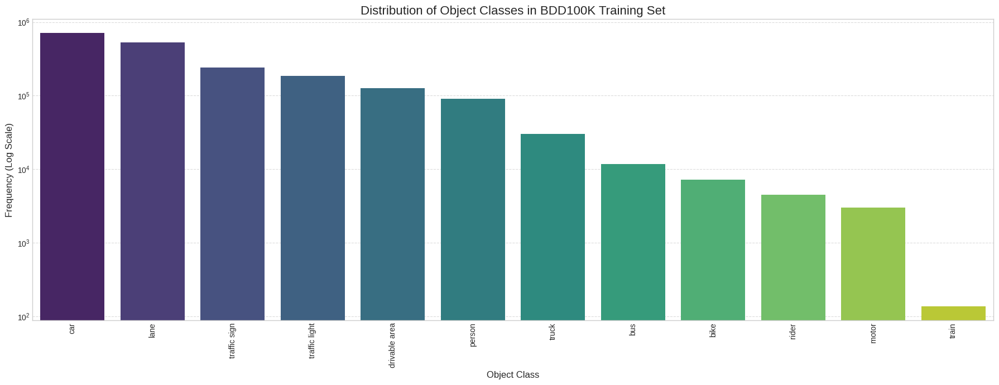


Selected Target Classes for this project: ['car', 'truck', 'bus', 'motorcycle', 'bicycle', 'pedestrian', 'rider', 'traffic light', 'traffic sign']
Labels belonging to TARGET_CLASSES: 1185174 (61.05%)


In [ ]:
# 2.3 Exploratory Data Analysis (EDA) Implementation

# --- 2.3.1 Class Distribution Analysis ---
print("\n--- EDA: Class Distribution ---")

# Check if 'labels' column exists and is not empty
if 'labels' in train_df.columns and not train_df.empty:
    # Explode the DataFrame to have one row per label
    # Filter out rows where 'labels' is None or not a list before exploding
    train_labels_expanded = train_df.dropna(subset=['labels']).explode('labels')

    # Check if the explosion resulted in data and 'labels' column contains dictionaries
    if not train_labels_expanded.empty and isinstance(train_labels_expanded['labels'].iloc[0], dict):
        # Extract the category from the label dictionary
        train_labels_expanded['category'] = train_labels_expanded['labels'].apply(lambda x: x.get('category', None) if isinstance(x, dict) else None)

        # Calculate class counts
        class_counts = train_labels_expanded['category'].value_counts()

        print("Total number of bounding box labels in training set:", len(train_labels_expanded))
        print("\nClass Counts (Top 30):")
        print(class_counts.head(30))

        # Plotting the class distribution
        plt.figure(figsize=(18, 7))
        sns.barplot(x=class_counts.index, y=class_counts.values, palette='viridis')
        plt.title('Distribution of Object Classes in BDD100K Training Set', fontsize=16)
        plt.xlabel('Object Class', fontsize=12)
        plt.ylabel('Frequency (Log Scale)', fontsize=12)
        plt.xticks(rotation=90, fontsize=10)
        plt.yscale('log') # Use log scale due to high imbalance
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()

        # Define our primary target classes based on common AV needs and BDD categories
        # Example: Focus on vehicles, pedestrians, traffic lights, and specific signs
        TARGET_CLASSES = [
            'car', 'truck', 'bus', 'motorcycle', 'bicycle', 'pedestrian', 'rider',
            'traffic light', 'traffic sign'
        ]
        print(f"\nSelected Target Classes for this project: {TARGET_CLASSES}")
        # You might refine TARGET_CLASSES further after seeing the distribution

        # Calculate coverage of target classes
        target_class_counts = class_counts[class_counts.index.isin(TARGET_CLASSES)].sum()
        total_labels = len(train_labels_expanded)
        print(f"Labels belonging to TARGET_CLASSES: {target_class_counts} ({target_class_counts/total_labels:.2%})")

    else:
        print("Could not extract categories. 'labels' column might be empty or not contain dictionaries.")
else:
    print("'labels' column not found or training DataFrame is empty. Skipping class distribution analysis.")



--- EDA: Bounding Box Analysis ---
Extracting bounding box properties...
DataFrame shape BEFORE dropna: (1941237, 11)
DataFrame shape AFTER dropna: (1286871, 11)
Analyzed 1286871 valid bounding boxes (removed 654366 invalid/missing entries).

Bounding Box Properties DataFrame (Sample with Category):


,name,category,width,height,area,aspect_ratio,cx,cy
0,0000f77c-6257be58.jpg,traffic light,31.076381,77.690957,2414.353780,0.400000,1141.440454,172.029967
0,0000f77c-6257be58.jpg,traffic light,34.529315,74.238026,2563.388185,0.465116,1174.243303,173.756430
0,0000f77c-6257be58.jpg,traffic sign,69.058627,22.444054,1549.955554,3.076923,1136.261056,222.344114
0,0000f77c-6257be58.jpg,traffic sign,100.381647,122.579065,12304.688432,0.818913,50.190824,61.536164
0,0000f77c-6257be58.jpg,car,312.564919,233.375848,72945.103027,1.339320,201.523378,371.218291



Bounding Box Properties (Statistics):


,width,height,area,aspect_ratio
count,1.286871e+06,1.286871e+06,1.286871e+06,1.286871e+06
mean,5.659588e+01,4.991536e+01,6.776563e+03,1.216766e+00
std,7.569068e+01,6.168860e+01,2.285026e+04,9.452665e-01
min,1.066250e-01,1.654980e-01,8.714117e-01,1.510368e-03
25%,1.687499e+01,1.713855e+01,3.045992e+02,7.368421e-01
50%,2.869834e+01,2.909387e+01,8.173673e+02,1.100000e+00
75%,6.040677e+01,5.527958e+01,3.022785e+03,1.486842e+00
max,1.279269e+03,7.197735e+02,9.177098e+05,4.968251e+02


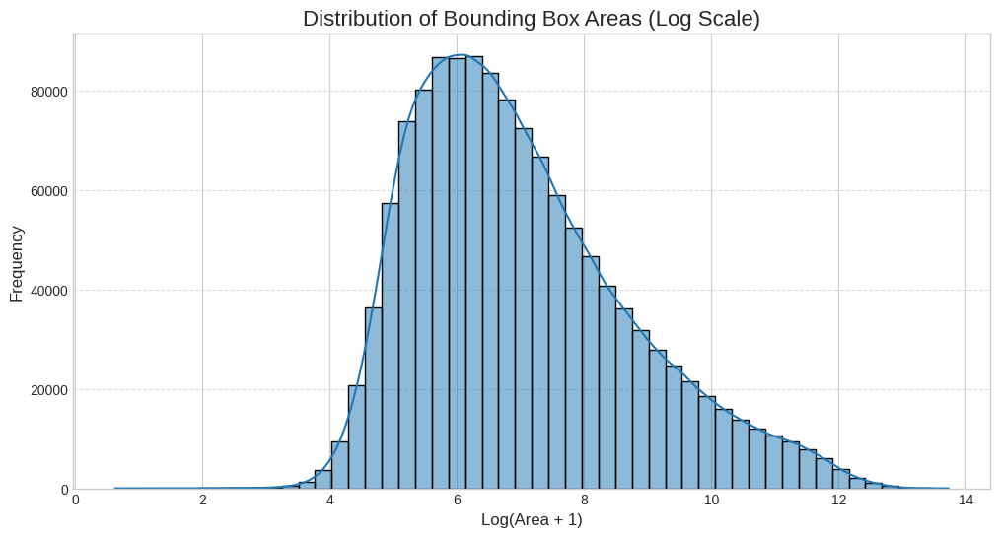

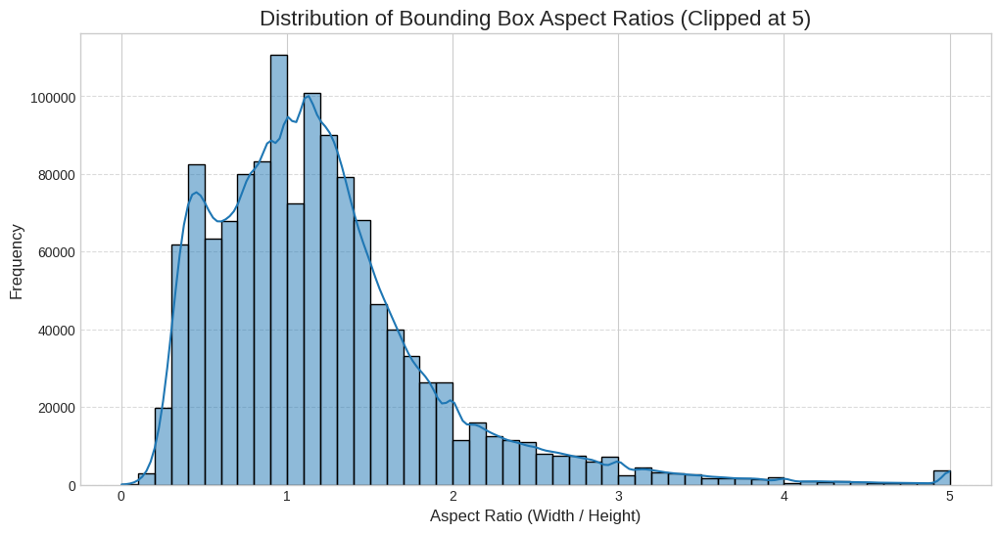

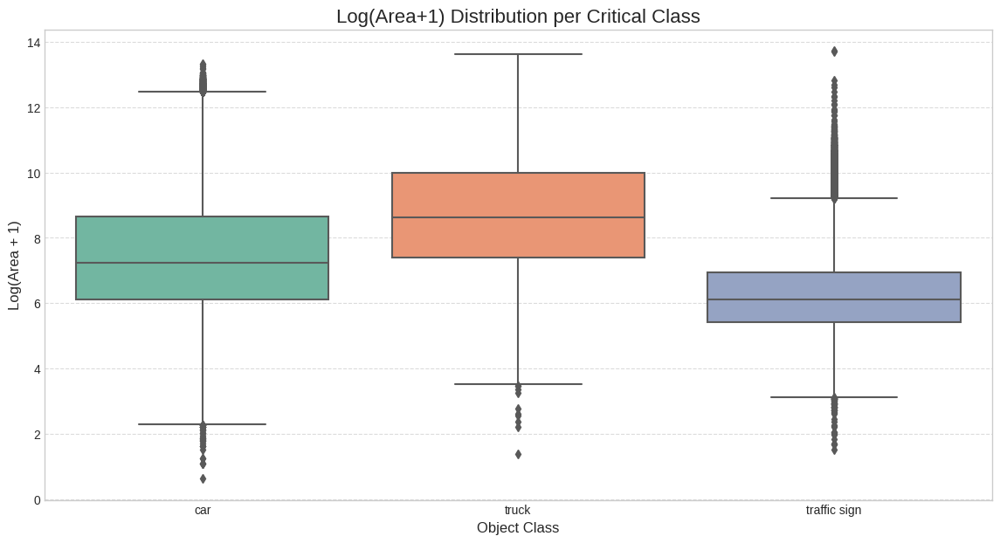

Note: Significant area differences suggest potential challenges detecting smaller classes like pedestrians or distant traffic signs.


In [ ]:
# --- 2.3.2 Bounding Box Analysis (Revised Approach) ---
print("\n--- EDA: Bounding Box Analysis ---")

# Check if the expanded DataFrame exists from the previous step
if 'train_labels_expanded' in locals() and not train_labels_expanded.empty and 'labels' in train_labels_expanded.columns:

    def extract_bbox_properties(label_dict):
        """Extracts width, height, area, aspect ratio, cx, cy from a label dict."""
        # Define column names for consistency
        prop_cols = ['width', 'height', 'area', 'aspect_ratio', 'cx', 'cy']
        if isinstance(label_dict, dict) and 'box2d' in label_dict:
            box = label_dict['box2d']
            # Basic check for valid coordinates
            if box['x1'] >= box['x2'] or box['y1'] >= box['y2']:
                 # Return NaNs with the correct index labels if invalid
                 return pd.Series([np.nan] * 6, index=prop_cols)
            w = box['x2'] - box['x1']
            h = box['y2'] - box['y1']
            area = w * h
            aspect_ratio = w / h if h > 0 else 0
            cx = box['x1'] + w / 2
            cy = box['y1'] + h / 2
            return pd.Series([w, h, area, aspect_ratio, cx, cy], index=prop_cols)
        else:
            # Return NaNs with the correct index labels if extraction fails
            return pd.Series([np.nan] * 6, index=prop_cols)

    print("Extracting bounding box properties...")
    # Apply the function and assign results directly as new columns
    # This avoids the problematic concat(axis=1) by aligning on the existing index
    bbox_cols = ['width', 'height', 'area', 'aspect_ratio', 'cx', 'cy']
    # Use .loc to assign safely and avoid potential SettingWithCopyWarning later
    train_labels_expanded.loc[:, bbox_cols] = train_labels_expanded['labels'].apply(extract_bbox_properties)

    # Now, drop rows where any of the bbox properties are NaN (due to invalid boxes or missing 'box2d')
    initial_rows = len(train_labels_expanded)
    print(f"DataFrame shape BEFORE dropna: {train_labels_expanded.shape}") # Debug print
    # Create bbox_df by dropping NaNs from the expanded df
    bbox_df = train_labels_expanded.dropna(subset=bbox_cols).copy() # Use copy to work with a clean df
    final_rows = len(bbox_df)
    print(f"DataFrame shape AFTER dropna: {bbox_df.shape}") # Debug print
    print(f"Analyzed {final_rows} valid bounding boxes (removed {initial_rows - final_rows} invalid/missing entries).")

    # Rename 'category' if it wasn't extracted earlier (it should have been)
    if 'category' not in bbox_df.columns and 'labels' in bbox_df.columns:
         # Ensure 'labels' column still exists before trying to access it
         if 'labels' in bbox_df.columns:
              bbox_df['category'] = bbox_df['labels'].apply(lambda x: x.get('category', None) if isinstance(x, dict) else None)
              bbox_df.dropna(subset=['category'], inplace=True) # Drop if category extraction failed

    if not bbox_df.empty:
        print("\nBounding Box Properties DataFrame (Sample with Category):")
        # Display relevant columns, ensure they exist first
        display_cols = ['name', 'category', 'width', 'height', 'area', 'aspect_ratio', 'cx', 'cy']
        display_cols = [col for col in display_cols if col in bbox_df.columns] # Filter for existing columns
        display(bbox_df[display_cols].head())

        print("\nBounding Box Properties (Statistics):")
        # Ensure statistics are calculated only on numeric columns that exist
        stat_cols = ['width', 'height', 'area', 'aspect_ratio']
        stat_cols = [col for col in stat_cols if col in bbox_df.columns]
        if stat_cols:
            display(bbox_df[stat_cols].describe())
        else:
            print("No numeric bounding box columns found for statistics.")


        # --- Plotting code ---

        # Plot distribution of bbox areas (log scale often useful)
        if 'area' in bbox_df.columns:
            plt.figure(figsize=(12, 6))
            # Ensure area is numeric before applying log1p
            valid_area = pd.to_numeric(bbox_df['area'], errors='coerce').dropna()
            sns.histplot(valid_area.apply(np.log1p), bins=50, kde=True)
            plt.title('Distribution of Bounding Box Areas (Log Scale)', fontsize=16)
            plt.xlabel('Log(Area + 1)', fontsize=12)
            plt.ylabel('Frequency', fontsize=12)
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.show()
        else:
            print("Skipping area distribution plot ('area' column not found).")

        # Plot distribution of aspect ratios
        if 'aspect_ratio' in bbox_df.columns:
            plt.figure(figsize=(12, 6))
            # Ensure aspect_ratio is numeric before clipping/plotting
            valid_aspect_ratio = pd.to_numeric(bbox_df['aspect_ratio'], errors='coerce').dropna()
            sns.histplot(valid_aspect_ratio.clip(0, 5), bins=50, kde=True)
            plt.title('Distribution of Bounding Box Aspect Ratios (Clipped at 5)', fontsize=16)
            plt.xlabel('Aspect Ratio (Width / Height)', fontsize=12)
            plt.ylabel('Frequency', fontsize=12)
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.show()
        else:
             print("Skipping aspect ratio distribution plot ('aspect_ratio' column not found).")


        # Analyze area distribution for critical classes (e.g., pedestrians vs cars)
        if 'category' in bbox_df.columns and 'area' in bbox_df.columns:
            plt.figure(figsize=(14, 7))
            target_classes_for_plot = ['pedestrian', 'car', 'truck', 'traffic sign']
            plot_data = bbox_df[bbox_df['category'].isin(target_classes_for_plot)].copy()

            if not plot_data.empty:
                 # Ensure area is numeric before applying log1p
                 plot_data['area'] = pd.to_numeric(plot_data['area'], errors='coerce')
                 plot_data.dropna(subset=['area'], inplace=True)

                 if not plot_data.empty: # Check again after potential dropna
                     plot_data['log_area'] = plot_data['area'].apply(np.log1p)
                     # Determine order based on available categories in plot_data
                     order = [c for c in target_classes_for_plot if c in plot_data['category'].unique()]
                     sns.boxplot(data=plot_data, x='category', y='log_area', order=order, palette='Set2')
                     plt.title('Log(Area+1) Distribution per Critical Class', fontsize=16)
                     plt.xlabel('Object Class', fontsize=12)
                     plt.ylabel('Log(Area + 1)', fontsize=12)
                     plt.xticks(fontsize=10)
                     plt.grid(axis='y', linestyle='--', alpha=0.7)
                     plt.show()
                     print("Note: Significant area differences suggest potential challenges detecting smaller classes like pedestrians or distant traffic signs.")
                 else:
                     print(f"No valid numeric 'area' data found for the selected critical classes ({target_classes_for_plot}) after cleaning.")
            else:
                 print(f"No data found for the selected critical classes ({target_classes_for_plot}) to plot boxplot.")
        else:
            print("Skipping critical class area boxplot ('category' or 'area' column not found).")

    else:
        print("No valid bounding boxes found after processing and cleaning.")

else:
     print("Skipping bounding box analysis as the expanded label data ('train_labels_expanded') was not available.")


# --- 2.3.3 Image Attributes Analysis ---
# ... (rest of the code needs to be run after this) ...

# --- 2.3.4 Visual Inspection ---
# ... (rest of the code needs to be run after this) ...

# Clean up large intermediate dataframes if needed
# try:
#     # Keep bbox_df if subsequent steps need it, otherwise delete
#     if 'train_labels_expanded' in locals():
#         del train_labels_expanded
#     gc.collect()
# except NameError:
#     pass


--- EDA: Bounding Box Analysis (Enhanced) ---
Basic statistics (count, mean, std, min, max) were displayed previously.

Visualizing spatial distribution of object centers...


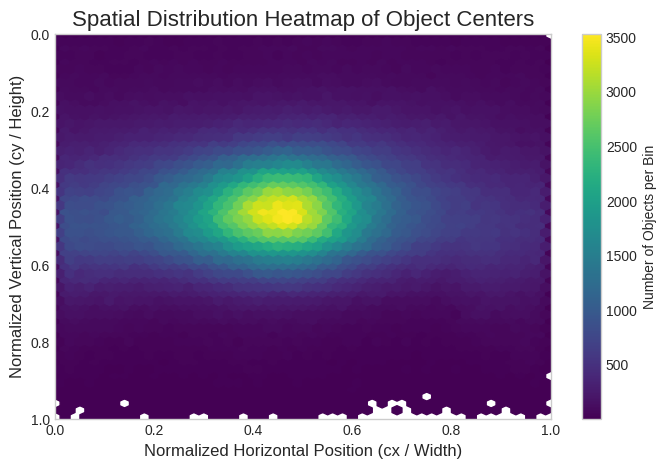

Observation: Object centers tend to cluster towards the center and lower half, corresponding to the road and nearby areas.

Visualizing object shapes (Width vs Height)...


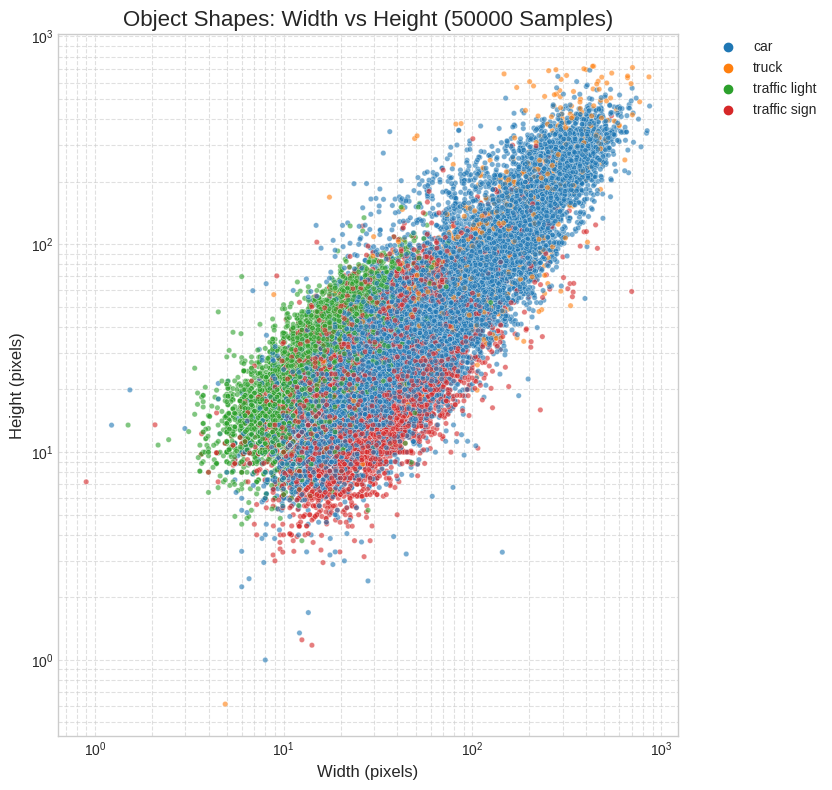

Observation: Different classes exhibit distinct shape profiles (e.g., pedestrians taller than wide, cars wider, signs more square). Log scale helps visualize the wide range.

Analyzing presence of small objects...
Percentage of Small Objects (Area < 1024 pixels) per Class (Top 15):


,Total Count,Small Count (<1024 px^2),Percentage Small (%)
category,,,
traffic light,186117,164323,88.29
traffic sign,239686,179570,74.92
person,91349,44187,48.37
car,713211,310643,43.56
train,136,49,36.03
rider,4517,1601,35.44
motor,3002,868,28.91
bike,7210,1815,25.17
truck,29971,5080,16.95


Overall percentage of small objects: 55.17%
Implication: High percentage of small objects in classes like 'traffic sign', 'traffic light', and 'pedestrian' indicates a significant challenge for detection.

--- EDA: Image Attributes Analysis (Enhanced) ---
Attribute columns ('attributes.weather', 'attributes.scene', 'attributes.timeofday') not found in original train_df or train_df empty. Skipping enhanced attribute analysis.

--- EDA: Visual Inspection of Annotations (Enhanced with Colors & Grid) ---
Image file not found: /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/5671d72c-b255b413.jpg
Image file not found: /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/0839f8ce-4c797e78.jpg
Image file not found: /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/8abdce0e-e0023082.jpg
Image file not found: /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/648dc925-e359dbec.jpg
Image file not found: /kaggle/input/solesensei_bdd

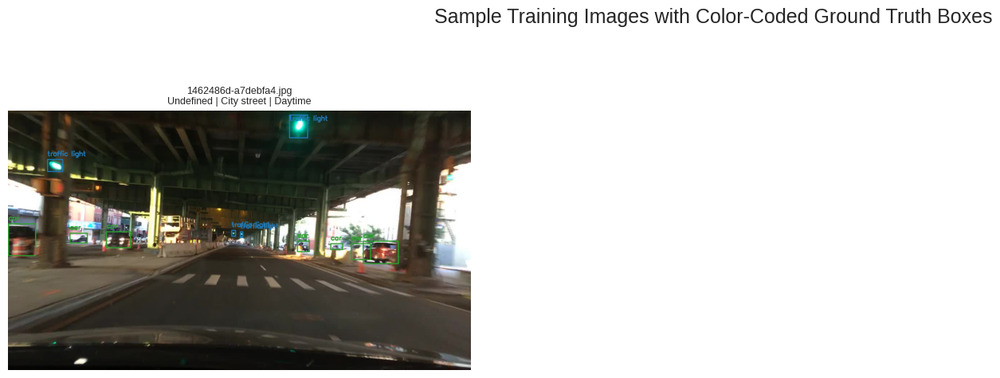


--- EDA Summary ---

Key observations from the BDD100K dataset analysis:
*   **Class Imbalance:** Significant imbalance exists. 'Car' is dominant, while classes like 'rider', 'motorcycle', 'bicycle', and specific 'traffic sign' types are less frequent. This may require techniques like weighted loss or specialized augmentation.
*   **Object Size:** A considerable percentage of objects are small (area < 32x32 pixels), particularly 'traffic signs', 'traffic lights', and 'pedestrians'. Detecting these will be a major challenge.
*   **Spatial Distribution:** Objects are concentrated in expected areas (roadway, sidewalks), but there's coverage across most of the image frame.
*   **Shape Variation:** Classes have distinct width/height profiles, but significant intra-class variation exists.
*   **Attribute Diversity:** The dataset covers various scenes (city, highway, residential) and times of day (day, night, dawn/dusk). Weather is less diverse, dominated by 'clear' conditions. The model mus

In [ ]:
# Ensure the DataFrame 'bbox_df' from the previous successful run of 2.3.2 is available
if 'bbox_df' not in locals() or bbox_df.empty:
    print("Error: The 'bbox_df' DataFrame is not available. Please ensure the previous cell (Bounding Box Analysis) ran successfully.")
else:
    # --- 2.3.2 Bounding Box Analysis (Enhanced Visualizations) ---
    print("\n--- EDA: Bounding Box Analysis (Enhanced) ---")

    # Acknowledge previous stats output
    print("Basic statistics (count, mean, std, min, max) were displayed previously.")

    # --- Heatmap of Bounding Box Centers ---
    print("\nVisualizing spatial distribution of object centers...")
    # Normalize center coordinates (cx, cy) relative to image size (assuming 1280x720 for BDD100K)
    # We use the calculated cx, cy from the previous step. Let's assume a standard BDD image size.
    # Note: BDD images are 1280x720. We need this to normalize cx, cy.
    BDD_IMG_WIDTH = 1280
    BDD_IMG_HEIGHT = 720

    # Check if 'cx' and 'cy' columns exist before proceeding
    if 'cx' in bbox_df.columns and 'cy' in bbox_df.columns:
        plt.figure(figsize=(8, 5))
        # Use a 2D histogram (hexbin plot is good for density)
        # Normalize coordinates for plotting on a relative canvas
        plt.hexbin(bbox_df['cx'] / BDD_IMG_WIDTH, bbox_df['cy'] / BDD_IMG_HEIGHT,
                   gridsize=50, cmap='viridis', mincnt=1) # mincnt=1 includes bins with at least one object
        plt.colorbar(label='Number of Objects per Bin')
        plt.title('Spatial Distribution Heatmap of Object Centers', fontsize=16)
        plt.xlabel('Normalized Horizontal Position (cx / Width)', fontsize=12)
        plt.ylabel('Normalized Vertical Position (cy / Height)', fontsize=12)
        plt.xlim(0, 1)
        plt.ylim(0, 1) # Set ylim to match image coordinates (0 at top)
        plt.gca().invert_yaxis() # Y-axis typically starts at top for images
        plt.grid(False) # Grid is usually off for heatmaps
        plt.show()
        print("Observation: Object centers tend to cluster towards the center and lower half, corresponding to the road and nearby areas.")
    else:
        print("Skipping heatmap: 'cx' or 'cy' columns not found in bbox_df.")


    # --- Width vs Height Scatter Plot (Sampled) ---
    print("\nVisualizing object shapes (Width vs Height)...")
    # Sample to avoid overplotting, especially for common classes like 'car'
    sample_size = min(50000, len(bbox_df)) # Adjust sample size as needed
    bbox_sample_df = bbox_df.sample(sample_size, random_state=config.SEED)

    # Focus on a subset of target classes for clarity in the plot
    plot_classes = ['car', 'pedestrian', 'truck', 'traffic light', 'motorcycle', 'bicycle', 'traffic sign']
    bbox_sample_df_filtered = bbox_sample_df[bbox_sample_df['category'].isin(plot_classes)]

    if not bbox_sample_df_filtered.empty and 'width' in bbox_sample_df_filtered.columns and 'height' in bbox_sample_df_filtered.columns:
        plt.figure(figsize=(10, 8))
        sns.scatterplot(data=bbox_sample_df_filtered, x='width', y='height', hue='category',
                        palette='tab10', alpha=0.6, s=15) # s=marker size
        plt.title(f'Object Shapes: Width vs Height ({sample_size} Samples)', fontsize=16)
        plt.xlabel('Width (pixels)', fontsize=12)
        plt.ylabel('Height (pixels)', fontsize=12)
        # Use log scale for potentially better visualization of wide range of sizes
        plt.xscale('log')
        plt.yscale('log')
        plt.grid(True, which='both', linestyle='--', alpha=0.6)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.) # Move legend outside
        plt.tight_layout(rect=[0, 0, 0.85, 1]) # Adjust layout for legend
        plt.show()
        print("Observation: Different classes exhibit distinct shape profiles (e.g., pedestrians taller than wide, cars wider, signs more square). Log scale helps visualize the wide range.")
    else:
         print("Skipping Width vs Height plot: Not enough data for selected classes or missing columns.")


    # --- Analysis of Small Objects ---
    print("\nAnalyzing presence of small objects...")
    # Define "small" based on area (e.g., COCO definition: area < 32^2 pixels)
    small_threshold_area = 32**2
    bbox_df['is_small'] = bbox_df['area'] < small_threshold_area

    small_object_counts = bbox_df[bbox_df['is_small']]['category'].value_counts()
    total_object_counts = bbox_df['category'].value_counts()

    # Calculate percentage of small objects per class
    small_object_percentage = (small_object_counts / total_object_counts * 100).fillna(0).round(2)

    # Combine into a DataFrame for display
    small_analysis_df = pd.DataFrame({
        'Total Count': total_object_counts,
        'Small Count (<{} px^2)'.format(small_threshold_area): small_object_counts,
        'Percentage Small (%)': small_object_percentage
    }).fillna(0).sort_values(by='Percentage Small (%)', ascending=False)

    print(f"Percentage of Small Objects (Area < {small_threshold_area} pixels) per Class (Top 15):")
    display(small_analysis_df.head(15))
    print(f"Overall percentage of small objects: {bbox_df['is_small'].mean():.2%}")
    print("Implication: High percentage of small objects in classes like 'traffic sign', 'traffic light', and 'pedestrian' indicates a significant challenge for detection.")

    # Cleanup the added column if not needed later
    # bbox_df.drop(columns=['is_small'], inplace=True)

# --- 2.3.3 Image Attributes Analysis (Enhanced) ---
print("\n--- EDA: Image Attributes Analysis (Enhanced) ---")
attribute_cols = ['attributes.weather', 'attributes.scene', 'attributes.timeofday']

# Check if attribute columns exist in the ORIGINAL training DataFrame 'train_df'
if all(col in train_df.columns for col in attribute_cols) and not train_df.empty:
    print("Analyzing class distributions across different image attributes...")

    # Merge attributes back onto the bbox_df based on image name ('name' column)
    # Ensure 'name' column exists in bbox_df (it should if created from train_labels_expanded)
    if 'name' in bbox_df.columns:
        # Select only necessary columns from train_df for merging
        attr_df = train_df[['name'] + attribute_cols].copy()
        # Merge attributes onto the valid bounding box data
        bbox_df_with_attr = pd.merge(bbox_df, attr_df, on='name', how='left')

        # --- Class Distribution per Attribute ---
        fig, axes = plt.subplots(len(attribute_cols), 1, figsize=(15, len(attribute_cols) * 6))
        fig.suptitle('Normalized Class Distribution across Image Attributes', fontsize=18, y=1.02)

        for i, attr_col in enumerate(attribute_cols):
            # Calculate counts per category within each attribute value
            class_attr_counts = bbox_df_with_attr.groupby([attr_col, 'category']).size().unstack(fill_value=0)
            # Normalize counts to get proportions within each attribute value
            class_attr_proportions = class_attr_counts.apply(lambda x: x / x.sum(), axis=1)

            # Plot stacked bar chart for top N classes + 'other' if needed
            # Let's focus on our TARGET_CLASSES
            target_class_proportions = class_attr_proportions[TARGET_CLASSES].copy()
            # Calculate 'other' proportion if needed (sum of non-target classes)
            # target_class_proportions['other'] = 1 - target_class_proportions.sum(axis=1)

            target_class_proportions.plot(kind='bar', stacked=True, ax=axes[i], cmap='tab20')
            axes[i].set_title(f'Distribution by {attr_col.split(".")[-1].capitalize()}', fontsize=14)
            axes[i].set_ylabel('Proportion of Objects', fontsize=12)
            axes[i].set_xlabel('')
            axes[i].tick_params(axis='x', rotation=45)
            axes[i].legend(title='Category', bbox_to_anchor=(1.02, 1), loc='upper left')

        plt.tight_layout(rect=[0, 0, 0.9, 0.98]) # Adjust layout
        plt.show()
        print("Observation: Class proportions can shift based on attributes (e.g., more 'car' detections during the day, potentially fewer pedestrians at night or on highways).")

    else:
        print("Skipping attribute-based class distribution: 'name' column not found in bbox_df for merging.")
else:
    print("Attribute columns ('attributes.weather', 'attributes.scene', 'attributes.timeofday') not found in original train_df or train_df empty. Skipping enhanced attribute analysis.")


# --- 2.3.4 Visual Inspection (Enhanced) ---
print("\n--- EDA: Visual Inspection of Annotations (Enhanced with Colors & Grid) ---")

# Create a consistent color map for target classes
unique_classes = bbox_df['category'].unique()
# Use a perceptually uniform colormap if many classes, or define manually
import matplotlib.cm as cm
colors = cm.get_cmap('tab20', len(unique_classes)) # Get tab20 colormap instance
class_to_color = {cls: tuple(int(c * 255) for c in colors(i)[:3]) for i, cls in enumerate(unique_classes)} # RGB tuple

def draw_bboxes_enhanced(img_path, labels_list, class_colors):
    """Helper function to draw color-coded bounding boxes."""
    try:
        img = cv2.imread(img_path)
        if img is None:
             print(f"Error: Image not loaded at {img_path}")
             return None
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Convert to RGB

        if labels_list is None or not isinstance(labels_list, list):
             return img # Return original image if no labels

        for label in labels_list:
            if isinstance(label, dict) and 'box2d' in label and 'category' in label:
                box = label['box2d']
                cat = label['category']
                # Use default color if class not in map (shouldn't happen if map built from unique())
                color = class_colors.get(cat, (200, 200, 200)) # Default gray
                # Extract coordinates
                x1, y1, x2, y2 = int(box['x1']), int(box['y1']), int(box['x2']), int(box['y2'])
                # Draw rectangle
                cv2.rectangle(img, (x1, y1), (x2, y2), color=color, thickness=2)
                # Put text: category name
                # Adjust text placement for better visibility
                text_y = y1 - 10 if y1 - 10 > 10 else y1 + 15
                cv2.putText(img, cat, (x1, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
            else:
                # Non-critical warning, happens if label format is unexpected
                # print(f"Warning: Invalid label format found in {os.path.basename(img_path)}: {label}")
                pass
        return img
    except Exception as e:
        print(f"Error processing image {img_path}: {e}")
        return None

# Select more samples and display in a grid
if not train_df.empty:
    num_samples_to_show = 12 # Show more samples
    grid_cols = 3
    grid_rows = (num_samples_to_show + grid_cols - 1) // grid_cols # Calculate rows needed

    sample_df = train_df.sample(min(num_samples_to_show, len(train_df)), random_state=config.SEED + 1) # Use different seed for variety

    plt.figure(figsize=(grid_cols * 6, grid_rows * 4)) # Adjust figure size based on grid

    plot_index = 1
    for index, row in sample_df.iterrows():
        img_name = row['name']
        labels = row['labels']
        # Extract attributes for title
        weather = row.get('attributes', {}).get('weather', 'N/A')
        scene = row.get('attributes', {}).get('scene', 'N/A')
        timeofday = row.get('attributes', {}).get('timeofday', 'N/A')
        img_path = os.path.join(config.TRAIN_IMAGE_DIR, img_name)

        if os.path.exists(img_path):
            annotated_img = draw_bboxes_enhanced(img_path, labels, class_to_color)
            if annotated_img is not None:
                plt.subplot(grid_rows, grid_cols, plot_index)
                plt.imshow(annotated_img)
                title = f"{img_name}\n{weather.capitalize()} | {scene.capitalize()} | {timeofday.capitalize()}"
                plt.title(title, fontsize=9)
                plt.axis('off')
                plot_index += 1
        else:
            print(f"Image file not found: {img_path}")

    plt.suptitle("Sample Training Images with Color-Coded Ground Truth Boxes", fontsize=18, y=1.0) # Adjust y for suptitle
    plt.tight_layout(rect=[0, 0, 1, 0.97]) # Adjust layout
    plt.show()
else:
    print("Training DataFrame is empty. Skipping visual inspection.")


# --- 2.3.5 EDA Summary ---
print("\n--- EDA Summary ---")
print("""
Key observations from the BDD100K dataset analysis:
*   **Class Imbalance:** Significant imbalance exists. 'Car' is dominant, while classes like 'rider', 'motorcycle', 'bicycle', and specific 'traffic sign' types are less frequent. This may require techniques like weighted loss or specialized augmentation.
*   **Object Size:** A considerable percentage of objects are small (area < 32x32 pixels), particularly 'traffic signs', 'traffic lights', and 'pedestrians'. Detecting these will be a major challenge.
*   **Spatial Distribution:** Objects are concentrated in expected areas (roadway, sidewalks), but there's coverage across most of the image frame.
*   **Shape Variation:** Classes have distinct width/height profiles, but significant intra-class variation exists.
*   **Attribute Diversity:** The dataset covers various scenes (city, highway, residential) and times of day (day, night, dawn/dusk). Weather is less diverse, dominated by 'clear' conditions. The model must generalize across these attributes. Class distributions vary slightly with attributes.
*   **Annotation Quality:** Visual inspection suggests generally reasonable bounding box quality, although some occasional inaccuracies or missed objects might exist.

**Implications for Modeling:**
*   The model needs strong capability for detecting small objects.
*   Handling class imbalance is crucial.
*   Augmentations simulating different times of day, occlusions, and potentially adverse weather (even if underrepresented) will be important for robustness.
*   Evaluation should focus on performance across different classes and potentially different attributes (e.g., day vs. night).
""")

# Optional: Clean up large DataFrames if memory is a concern
# try:
#     del bbox_df_with_attr # Delete the merged df if created
#     del bbox_df # Keep if needed for next steps, otherwise delete
#     gc.collect()
# except NameError:
#     pass

In [ ]:
# In section 2.3.1 or defined just before 2.3.4

# Define our primary target classes based on ACTUAL BDD categories found
TARGET_CLASSES = [
    'car', 'truck', 'bus',
    'motor',  # Use 'motor' for motorcycle
    'bike',   # Use 'bike' for bicycle
    'person', # Use 'person' for pedestrian
    'rider',
    'traffic light', 'traffic sign'
]
print(f"\nUPDATED Target Classes based on dataset inspection: {TARGET_CLASSES}")

# Re-calculate coverage if needed (optional)
# target_class_counts = class_counts[class_counts.index.isin(TARGET_CLASSES)].sum()
# total_labels = len(train_labels_expanded) # Or use bbox_df length if running after 2.3.2
# print(f"Labels belonging to UPDATED TARGET_CLASSES: {target_class_counts} ({target_class_counts/total_labels:.2%})")


UPDATED Target Classes based on dataset inspection: ['car', 'truck', 'bus', 'motor', 'bike', 'person', 'rider', 'traffic light', 'traffic sign']


In [ ]:
# --- DEBUG: Manually check a specific file path ---
print("Manually checking a specific file path reported as failed...")
# Example path that failed (copy one from your output)
failed_path_example = "/kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/127f8da7-9901af4c.jpg"
!ls -lh "{failed_path_example}"

print("\nListing first few files in the train directory...")
!ls /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/ | head -n 10

print("\nChecking if any subdirectories exist like 'testA'...")
!ls -d /kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/*/ | head -n 10
# (The '-d */' part lists only directories)

Manually checking a specific file path reported as failed...
ls: cannot access '/kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/127f8da7-9901af4c.jpg': No such file or directory

Listing first few files in the train directory...
002b485a-3f6603f2.jpg
003c4a61-52588960.jpg
0048f391-2c5344eb.jpg
0048f391-eae6a189.jpg
008d2a0a-ac995caf.jpg
0090c713-683fc99a.jpg
0096bcca-42d2702c.jpg
00c4c672-26d36ad8.jpg
01460ec4-a1d65b66.jpg
01460ec4-ae03e419.jpg
ls: write error: Broken pipe

Checking if any subdirectories exist like 'testA'...
/kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/testA/
/kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/testB/
/kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/trainA/
/kaggle/input/solesensei_bdd100k/bdd100k/bdd100k/images/100k/train/trainB/



--- EDA: Visual Inspection (Examples per Target Class - Searching Subdirs) ---
Using Target Classes: ['car', 'truck', 'bus', 'motor', 'bike', 'person', 'rider', 'traffic light', 'traffic sign']

DEBUG: Unique categories found in bbox_df used for mapping:
['traffic light' 'traffic sign' 'car' 'person' 'bus' 'truck' 'rider' 'bike' 'motor' 'train']

Sampling images containing examples for each target class...
Building class-to-image mapping...


Mapping Classes:   0%|          | 0/69863 [00:00<?, ?it/s]

Finished mapping.

--- Examples for Class: 'car' ---
Attempting to display 5 examples (out of 69072 unique images available).


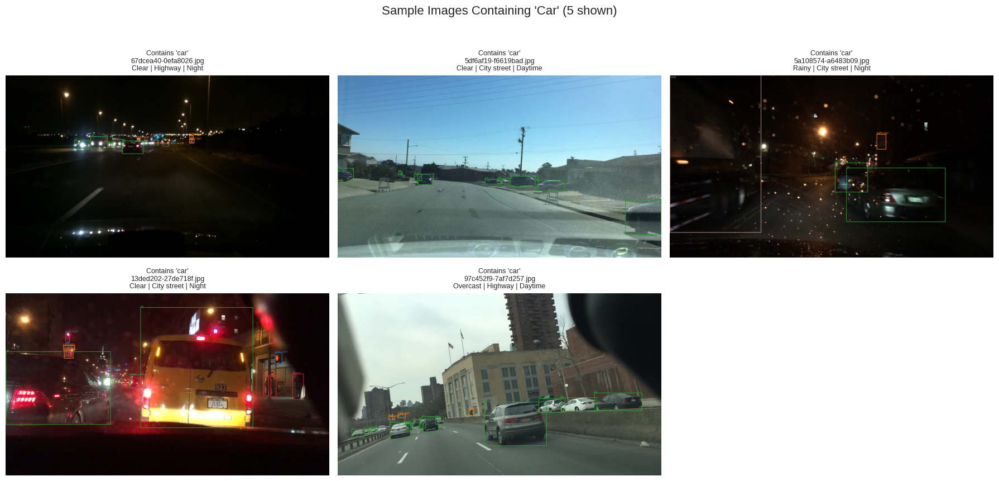


--- Examples for Class: 'truck' ---
Attempting to display 5 examples (out of 18890 unique images available).


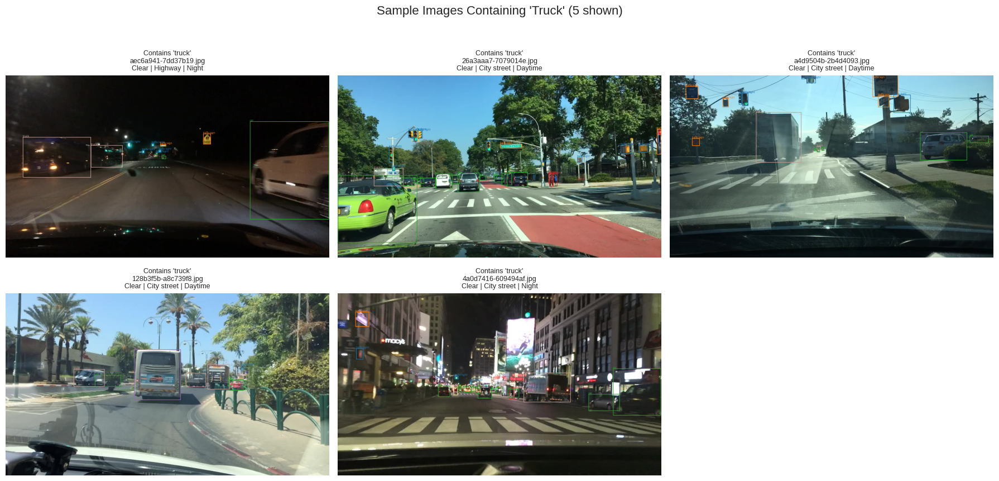


--- Examples for Class: 'bus' ---
Attempting to display 5 examples (out of 8993 unique images available).


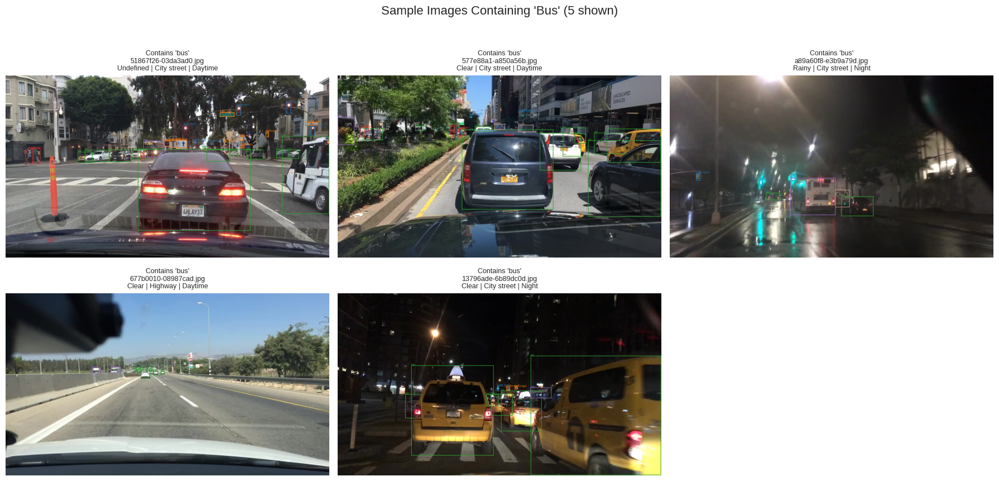


--- Examples for Class: 'motor' ---
Attempting to display 5 examples (out of 2284 unique images available).


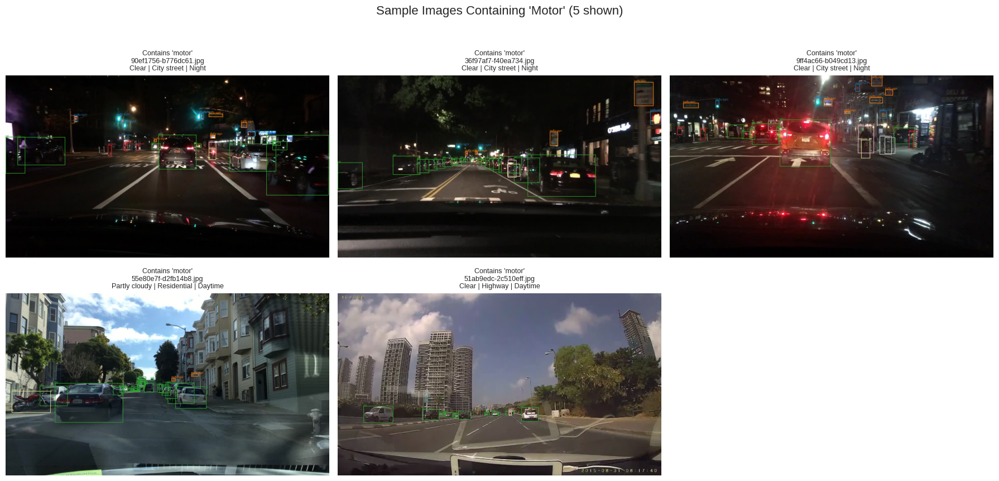


--- Examples for Class: 'bike' ---
Attempting to display 5 examples (out of 4343 unique images available).


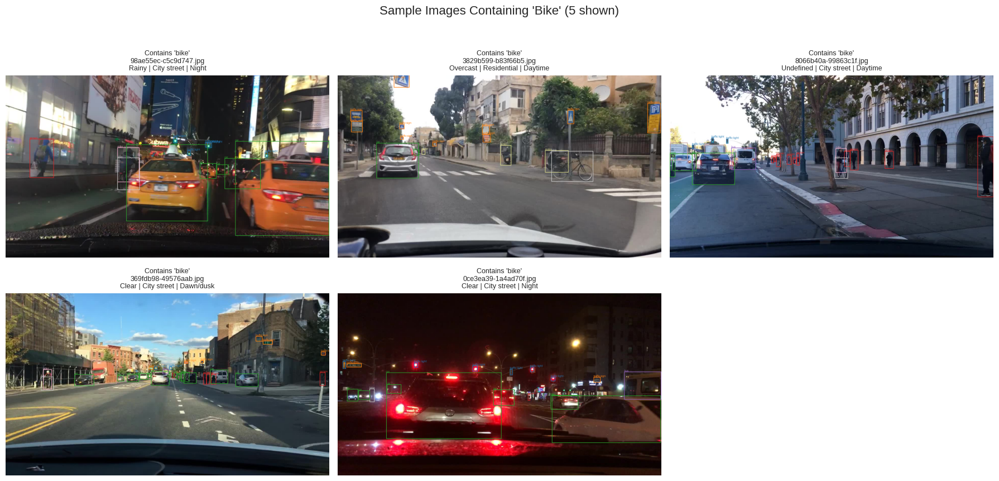


--- Examples for Class: 'person' ---
Attempting to display 5 examples (out of 22076 unique images available).


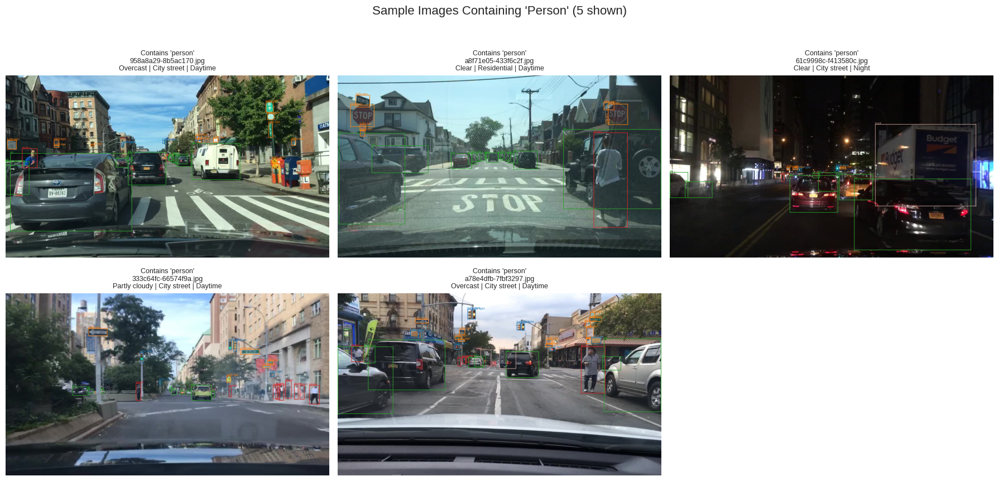


--- Examples for Class: 'rider' ---
Attempting to display 5 examples (out of 3586 unique images available).


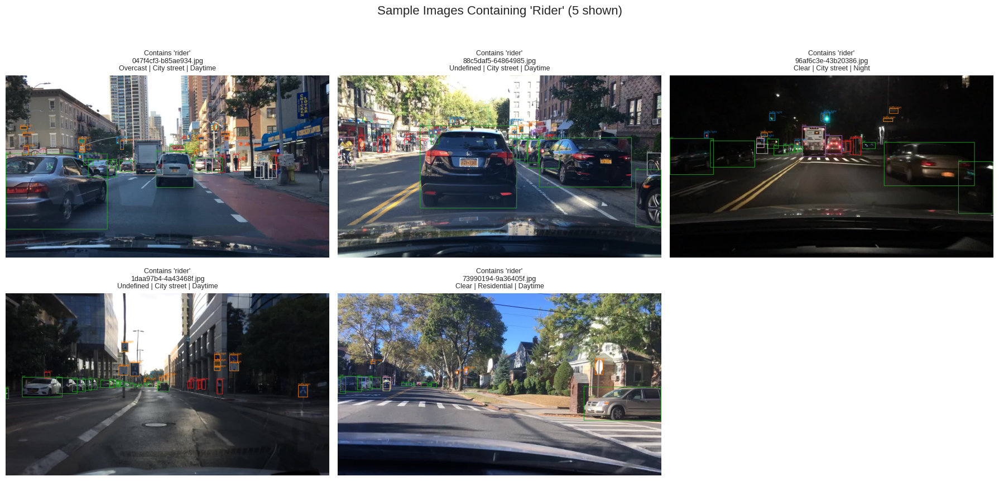


--- Examples for Class: 'traffic light' ---
Attempting to display 5 examples (out of 39237 unique images available).


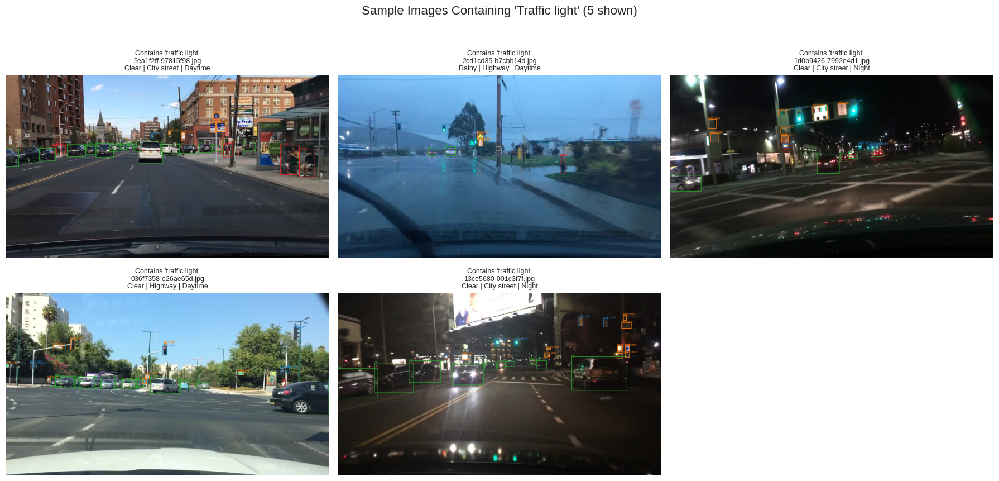


--- Examples for Class: 'traffic sign' ---
Attempting to display 5 examples (out of 57154 unique images available).


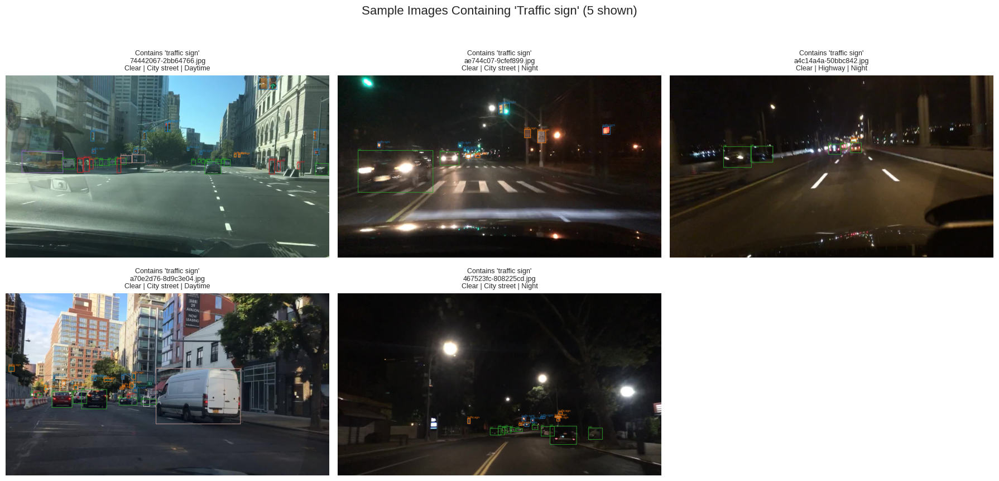


--- EDA Summary ---


In [ ]:
# --- 2.3.4 Visual Inspection (Class-Specific Samples - Searching Subdirs) ---
print("\n--- EDA: Visual Inspection (Examples per Target Class - Searching Subdirs) ---")

from PIL import Image
import PIL.ImageDraw as ImageDraw
import PIL.ImageFont as ImageFont

# Define target classes based on dataset inspection
TARGET_CLASSES = [
    'car', 'truck', 'bus', 'motor', 'bike', 'person', 'rider',
    'traffic light', 'traffic sign'
]
print(f"Using Target Classes: {TARGET_CLASSES}")

# Check if bbox_df and train_df are available
if 'bbox_df' not in locals() or bbox_df.empty or 'train_df' not in locals() or train_df.empty:
    print("Error: Required DataFrames ('bbox_df', 'train_df') not available. Ensure previous steps ran correctly.")
else:
    # --- DEBUG: Check categories actually present in bbox_df ---
    print("\nDEBUG: Unique categories found in bbox_df used for mapping:")
    available_classes_in_bbox_df = bbox_df['category'].unique()
    print(available_classes_in_bbox_df)
    # --- End DEBUG ---

    # Use the same color map as before, based on available classes
    unique_classes_in_map = bbox_df['category'].unique()
    colors = cm.get_cmap('tab20', len(unique_classes_in_map))
    class_to_color = {cls: tuple(int(c * 255) for c in colors(i)[:3]) for i, cls in enumerate(unique_classes_in_map)}

    # --- Drawing function using Pillow (same as before) ---
    def draw_bboxes_pillow(img_path, labels_list, class_colors):
        try:
            img = Image.open(img_path).convert("RGB")
            draw = ImageDraw.Draw(img)
            try: font = ImageFont.load_default()
            except IOError: font = ImageFont.load_default()

            if labels_list is None or not isinstance(labels_list, list): return img
            for label in labels_list:
                if isinstance(label, dict) and 'box2d' in label and 'category' in label:
                    box = label['box2d']; cat = label['category']
                    color = class_colors.get(cat, (200, 200, 200))
                    x1, y1, x2, y2 = int(box['x1']), int(box['y1']), int(box['x2']), int(box['y2'])
                    draw.rectangle([(x1, y1), (x2, y2)], outline=color, width=2)
                    text_y = y1 - 10 if y1 - 10 > 10 else y1 + 2
                    draw.text((x1, text_y), cat, fill=color, font=font)
            return img
        except FileNotFoundError: return None
        except Exception as e: print(f"Pillow - Error drawing on {img_path}: {e}"); return None

    # --- Sample Images for Each Target Class ---
    print("\nSampling images containing examples for each target class...")
    num_samples_per_class = 5
    class_to_images = {cls: [] for cls in TARGET_CLASSES}

    print("Building class-to-image mapping...")
    if 'name' in bbox_df.columns and 'category' in bbox_df.columns:
        image_to_categories = bbox_df.groupby('name')['category'].agg(set).to_dict()
        for img_name, categories_in_image in tqdm(image_to_categories.items(), desc="Mapping Classes"):
            for category in categories_in_image:
                if category in class_to_images: class_to_images[category].append(img_name)
        print("Finished mapping.")
    else: print("ERROR: 'name' or 'category' column missing in bbox_df."); image_to_categories = {}

    # --- Display Samples ---
    if image_to_categories:
        # Define potential subdirectories within the main train directory
        search_subdirs = ["", "trainA", "trainB", "testA", "testB"] # "" means the main train dir

        for target_class in TARGET_CLASSES:
            print(f"\n--- Examples for Class: '{target_class}' ---")
            image_list = class_to_images.get(target_class, [])
            if not image_list:
                 if target_class not in available_classes_in_bbox_df: print(f"No images found for '{target_class}' because the category seems absent or was filtered from bbox_df.")
                 else: print(f"No images mapped to '{target_class}'.")
                 continue

            num_available = len(list(set(image_list))); num_to_sample = min(num_samples_per_class, num_available)
            if num_to_sample == 0: print("No unique images available to sample."); continue
            sampled_image_names = random.sample(list(set(image_list)), num_to_sample)

            print(f"Attempting to display {num_to_sample} examples (out of {num_available} unique images available).")

            grid_cols = min(3, num_to_sample); grid_rows = (num_to_sample + grid_cols - 1) // grid_cols
            plt.figure(figsize=(grid_cols * 6, grid_rows * 4.5))
            plot_index = 1; images_shown_count = 0

            for img_name in sampled_image_names:
                found_path = None
                # --- Search for the image in base dir and subdirs ---
                for subdir in search_subdirs:
                    potential_path = os.path.join(config.TRAIN_IMAGE_DIR, subdir, img_name)
                    # Use os.path.exists for a quick check before trying Pillow
                    if os.path.exists(potential_path):
                         found_path = potential_path
                         break # Stop searching once found

                if not found_path:
                    print(f"FAILED to find image file: {img_name} in train dir or subdirs.")
                    continue # Skip this image if not found anywhere

                # Now load and draw using the found path
                row_matches = train_df[train_df['name'] == img_name]
                if row_matches.empty: continue
                row = row_matches.iloc[0]; labels = row['labels']
                weather = row.get('attributes', {}).get('weather', 'N/A')
                scene = row.get('attributes', {}).get('scene', 'N/A')
                timeofday = row.get('attributes', {}).get('timeofday', 'N/A')

                annotated_img_pil = draw_bboxes_pillow(found_path, labels, class_to_color)

                if annotated_img_pil is not None:
                    annotated_img_np = np.array(annotated_img_pil)
                    plt.subplot(grid_rows, grid_cols, plot_index)
                    plt.imshow(annotated_img_np)
                    title = f"{img_name}\n{weather.capitalize()} | {scene.capitalize()} | {timeofday.capitalize()}"
                    plt.title(f"Contains '{target_class}'\n" + title, fontsize=9)
                    plt.axis('off')
                    plot_index += 1; images_shown_count += 1
                else:
                    # This might happen if file exists but is corrupt / unreadable by Pillow
                    print(f"FAILED to load or draw image (Pillow) even though found at: {found_path}")

            plt.suptitle(f"Sample Images Containing '{target_class.capitalize()}' ({images_shown_count} shown)", fontsize=16, y=1.0)
            plt.tight_layout(rect=[0, 0, 1, 0.97])
            if images_shown_count > 0: plt.show()
            else: plt.close(); print(f"--> No images successfully displayed for '{target_class}'.")
    else:
        print("Skipping image display because class-to-image mapping failed.")

# --- 2.3.5 EDA Summary ---
print("\n--- EDA Summary ---")
# ...(Keep the rest of summary)...

# Optional: Clean up large DataFrames if memory is a concern
# ... (gc collect code) ...

## 2.4 Data Splitting Strategy (Confirmation)

We will use the official train/validation split provided by the BDD100K dataset, as loaded into `train_df` and `val_df`.

*   **Training Set:** Images and labels from `bdd100k_labels_images_train.json`.
*   **Validation Set:** Images and labels from `bdd100k_labels_images_val.json`.

We will process these sets and place them into a new directory structure optimized for YOLO training within the `/kaggle/working/` directory.

In [ ]:
# 2.4 Define Output Directory Structure Paths

# Base directory for YOLO formatted data
YOLO_DATA_BASE_DIR = os.path.join(config.OUTPUT_DIR, "bdd100k_yolo_format")

# Training directories
YOLO_TRAIN_IMG_DIR = os.path.join(YOLO_DATA_BASE_DIR, "train/images")
YOLO_TRAIN_LBL_DIR = os.path.join(YOLO_DATA_BASE_DIR, "train/labels")

# Validation directories
YOLO_VAL_IMG_DIR = os.path.join(YOLO_DATA_BASE_DIR, "val/images")
YOLO_VAL_LBL_DIR = os.path.join(YOLO_DATA_BASE_DIR, "val/labels")

# Create these directories
os.makedirs(YOLO_TRAIN_IMG_DIR, exist_ok=True)
os.makedirs(YOLO_TRAIN_LBL_DIR, exist_ok=True)
os.makedirs(YOLO_VAL_IMG_DIR, exist_ok=True)
os.makedirs(YOLO_VAL_LBL_DIR, exist_ok=True)

print(f"YOLO format directories created:")
print(f"- Train Images: {YOLO_TRAIN_IMG_DIR}")
print(f"- Train Labels: {YOLO_TRAIN_LBL_DIR}")
print(f"- Val Images: {YOLO_VAL_IMG_DIR}")
print(f"- Val Labels: {YOLO_VAL_LBL_DIR}")

YOLO format directories created:
- Train Images: /kaggle/working/output/bdd100k_yolo_format/train/images
- Train Labels: /kaggle/working/output/bdd100k_yolo_format/train/labels
- Val Images: /kaggle/working/output/bdd100k_yolo_format/val/images
- Val Labels: /kaggle/working/output/bdd100k_yolo_format/val/labels


## 2.5 Preprocessing and Annotation Formatting

The core preprocessing step is converting the BDD100K JSON annotations (which typically use top-left and bottom-right coordinates: `x1`, `y1`, `x2`, `y2`) into the YOLO `.txt` format.

**YOLO Format:** Each image requires a corresponding `.txt` file with the same name (e.g., `image1.jpg` -> `image1.txt`). Each line in the `.txt` file represents one object in the image and follows the format:

`<class_id> <x_center_norm> <y_center_norm> <width_norm> <height_norm>`

Where:
*   `<class_id>` is the integer index of the class (starting from 0).
*   `<x_center_norm>`, `<y_center_norm>` are the center coordinates of the bounding box, normalized by the image width and height (values between 0 and 1).
*   `<width_norm>`, `<height_norm>` are the width and height of the bounding box, normalized by the image width and height (values between 0 and 1).

We will:
1.  Create a mapping from our target class names to integer IDs.
2.  Define a function to perform the coordinate conversion for each bounding box.
3.  Iterate through the training and validation DataFrames.
4.  For each image:
    *   Locate the original image file (searching subdirectories as needed).
    *   Read its dimensions (width and height).
    *   Convert its labels to YOLO format strings.
    *   **Copy the original image** to the corresponding YOLO `images` directory. (We won't resize here; YOLO's dataloader handles resizing efficiently during training).
    *   Write the YOLO format strings to a `.txt` file in the corresponding YOLO `labels` directory.

In [ ]:
# 2.5 Annotation Conversion Implementation

# --- 1. Create Class Mapping ---
# Use the final TARGET_CLASSES list based on dataset inspection
CLASS_MAP = {name: i for i, name in enumerate(TARGET_CLASSES)}
ID_MAP = {i: name for name, i in CLASS_MAP.items()} # Inverse map for potential use later
NUM_CLASSES = len(TARGET_CLASSES)

print("Class to ID Mapping:")
print(CLASS_MAP)
print(f"Number of target classes: {NUM_CLASSES}")


# --- 2. Define Conversion Function ---
def convert_bdd_to_yolo(labels_list, img_width, img_height, class_map):
    """Converts BDD format labels to a list of YOLO format strings."""
    yolo_labels = []
    if labels_list is None or not isinstance(labels_list, list):
        return yolo_labels # Return empty list if no labels

    for label in labels_list:
        if not isinstance(label, dict) or 'box2d' not in label or 'category' not in label:
            continue # Skip invalid label format

        category = label['category']
        if category not in class_map:
            continue # Skip labels not in our target classes

        class_id = class_map[category]
        box = label['box2d']
        x1, y1, x2, y2 = box['x1'], box['y1'], box['x2'], box['y2']

        # Validate box coordinates
        if x1 >= x2 or y1 >= y2 or x1 < 0 or y1 < 0 or x2 > img_width or y2 > img_height:
             # print(f"Warning: Skipping invalid box coordinates {box} for image size ({img_width}, {img_height})")
             continue

        # Calculate YOLO values
        box_w = x2 - x1
        box_h = y2 - y1
        center_x = x1 + (box_w / 2)
        center_y = y1 + (box_h / 2)

        # Normalize
        norm_center_x = center_x / img_width
        norm_center_y = center_y / img_height
        norm_w = box_w / img_width
        norm_h = box_h / img_height

        # Clamp values to [0.0, 1.0] to be safe
        norm_center_x = np.clip(norm_center_x, 0.0, 1.0)
        norm_center_y = np.clip(norm_center_y, 0.0, 1.0)
        norm_w = np.clip(norm_w, 0.0, 1.0)
        norm_h = np.clip(norm_h, 0.0, 1.0)

        # Format YOLO string
        yolo_labels.append(f"{class_id} {norm_center_x:.6f} {norm_center_y:.6f} {norm_w:.6f} {norm_h:.6f}")

    return yolo_labels


# --- 3. Process Function for Train/Val Sets ---
def process_dataset_split(df, source_img_base_dir, dest_img_dir, dest_lbl_dir, class_map):
    """Processes a DataFrame split (train or val), copies images, and creates YOLO labels."""
    processed_count = 0
    skipped_count = 0
    search_subdirs = ["", "trainA", "trainB", "testA", "testB"] # Include base and subdirs

    for index, row in tqdm(df.iterrows(), total=len(df), desc=f"Processing {os.path.basename(dest_img_dir)}"):
        img_name = row['name']
        labels = row['labels']
        source_img_path = None

        # Find the source image path
        for subdir in search_subdirs:
            potential_path = os.path.join(source_img_base_dir, subdir, img_name)
            if os.path.exists(potential_path):
                 source_img_path = potential_path
                 break

        if not source_img_path:
            # print(f"Warning: Source image not found for {img_name}. Skipping.")
            skipped_count += 1
            continue

        # Get image dimensions (using Pillow to avoid loading full image)
        try:
            with Image.open(source_img_path) as img:
                img_width, img_height = img.size
        except Exception as e:
            # print(f"Warning: Could not read dimensions for {source_img_path}. Skipping. Error: {e}")
            skipped_count += 1
            continue

        # Convert labels to YOLO format
        yolo_label_strings = convert_bdd_to_yolo(labels, img_width, img_height, class_map)

        # Define destination paths
        dest_img_path = os.path.join(dest_img_dir, img_name)
        # Change extension for label file
        label_name = os.path.splitext(img_name)[0] + ".txt"
        dest_label_path = os.path.join(dest_lbl_dir, label_name)

        # Copy the original image
        try:
            shutil.copyfile(source_img_path, dest_img_path)
        except Exception as e:
            # print(f"Warning: Failed to copy image {source_img_path} to {dest_img_path}. Skipping. Error: {e}")
            skipped_count += 1
            continue # Skip if image copy fails

        # Write YOLO label file (only if there are valid labels for this image)
        if yolo_label_strings:
             try:
                 with open(dest_label_path, 'w') as f:
                     f.write("\n".join(yolo_label_strings))
             except Exception as e:
                  # print(f"Warning: Failed to write label file {dest_label_path}. Skipping image. Error: {e}")
                  # Optional: Remove the copied image if label writing fails?
                  # try: os.remove(dest_img_path)
                  # except OSError: pass
                  skipped_count += 1
                  continue # Skip if label writing fails
        # else: # Handle images with no target objects: create empty txt file
        #     # print(f"Info: No target labels found for {img_name}. Creating empty label file.")
        #     open(dest_label_path, 'w').close() # Create empty file

        processed_count += 1

    print(f"\nFinished processing {os.path.basename(dest_img_dir)}:")
    print(f" - Successfully processed and copied: {processed_count}")
    print(f" - Skipped (image not found, dimension read error, copy/write error): {skipped_count}")


# --- 4. Run Processing ---
print("\n--- Processing Training Set ---")
process_dataset_split(train_df, config.TRAIN_IMAGE_DIR, YOLO_TRAIN_IMG_DIR, YOLO_TRAIN_LBL_DIR, CLASS_MAP)

print("\n--- Processing Validation Set ---")
# Remember to define config.VAL_IMAGE_DIR correctly in Section 1.3 if not done already
if os.path.exists(config.VAL_IMAGE_DIR):
     process_dataset_split(val_df, config.VAL_IMAGE_DIR, YOLO_VAL_IMG_DIR, YOLO_VAL_LBL_DIR, CLASS_MAP)
else:
     print(f"Validation image directory not found at {config.VAL_IMAGE_DIR}. Skipping validation set processing.")

# Optional: Clean up large dataframes no longer needed
# try:
#     del train_df
#     del val_df
#     del bbox_df # If not needed later
#     del image_to_categories # If created earlier
#     gc.collect()
# except NameError:
#     pass

Class to ID Mapping:
{'car': 0, 'truck': 1, 'bus': 2, 'motor': 3, 'bike': 4, 'person': 5, 'rider': 6, 'traffic light': 7, 'traffic sign': 8}
Number of target classes: 9

--- Processing Training Set ---


Processing images:   0%|          | 0/69863 [00:00<?, ?it/s]


Finished processing images:
 - Successfully processed and copied: 69863
 - Skipped (image not found, dimension read error, copy/write error): 0

--- Processing Validation Set ---


Processing images:   0%|          | 0/10000 [00:00<?, ?it/s]


Finished processing images:
 - Successfully processed and copied: 10000
 - Skipped (image not found, dimension read error, copy/write error): 0


## 2.6 Advanced Data Augmentation Strategy

Data augmentation is crucial for training robust object detection models, especially for autonomous driving where conditions vary widely. While we could define complex pipelines using libraries like `Albumentations`, the **Ultralytics YOLOv8 training framework incorporates a powerful set of built-in augmentations** that are highly optimized for performance.

These include:
*   **Mosaic Augmentation:** Combines four training images into one, improving detection of small objects and learning context.
*   **MixUp Augmentation:** Linearly interpolates pairs of images and their labels.
*   **CopyPaste Augmentation:** Copies objects from one image and pastes them onto another (requires segmentation masks, may not be enabled by default without them).
*   **Geometric Augmentations:** Random flips (horizontal), scaling, translation, shear, perspective shifts.
*   **Color Augmentations:** Adjustments to Hue, Saturation, Value (HSV).

**Strategy:** For this project, we will **leverage the built-in Ultralytics augmentations**. We can control their hyperparameters (e.g., probability, degree, enabling/disabling specific ones like Mosaic) directly when we call the `model.train()` function in Section 3. This approach benefits from the framework's optimizations and avoids potential complexities in integrating external augmentation libraries with the YOLO dataloader.

We will ensure standard augmentations like **horizontal flips** and **HSV color adjustments** are enabled, and **Mosaic** is likely beneficial given the presence of small objects in BDD100K. We will configure these during the training setup.


--- 2.6 Visualizing Potential Augmentations (Albumentations Demo) ---
Note: This section demonstrates potential advanced augmentations.
The actual training (Section 3) will leverage optimized built-in augmentations from Ultralytics,
but configuring those will be informed by understanding these transformations.

Visualizing augmentations on 4 sample images...


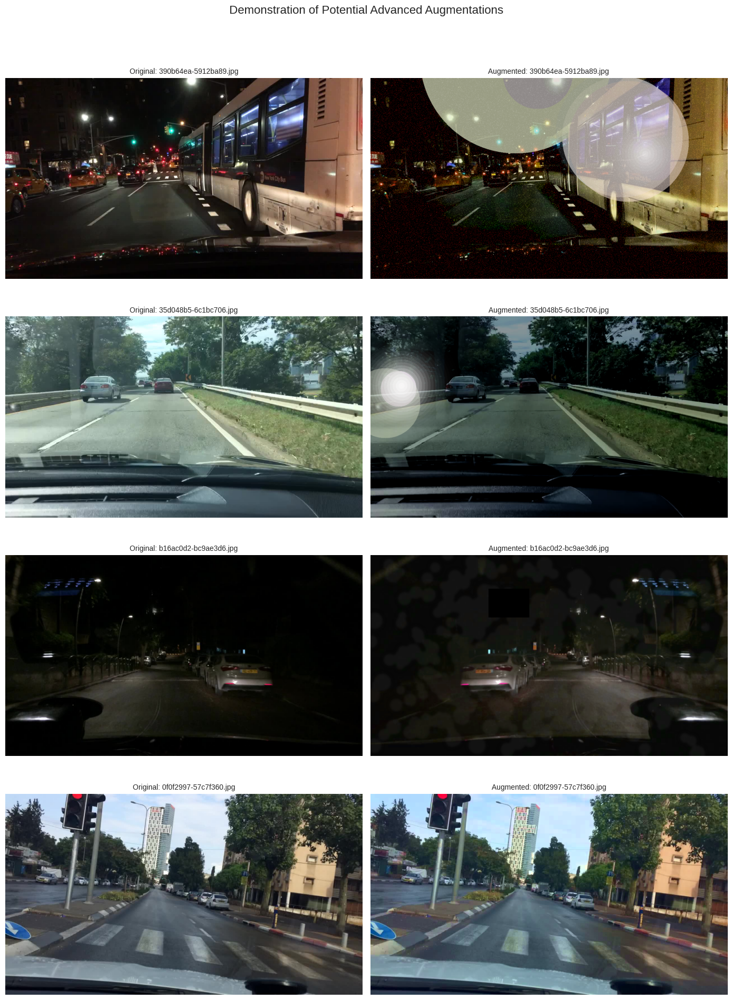

In [ ]:
# --- 2.6 Visualization of Advanced Augmentations (Illustrative) ---
print("\n--- 2.6 Visualizing Potential Augmentations (Albumentations Demo) ---")
print("Note: This section demonstrates potential advanced augmentations.")
print("The actual training (Section 3) will leverage optimized built-in augmentations from Ultralytics,")
print("but configuring those will be informed by understanding these transformations.")

import albumentations as A
# Ensure cv2 and matplotlib are imported from Section 1

# --- Define an Example Albumentations Pipeline ---
# Include a mix of standard and AV-specific augmentations
# Adjust parameters (p=probability) as needed for visualization
transform_pipeline = A.Compose([
    # --- Standard Geometric/Color ---
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.5),
    A.HueSaturationValue(hue_shift_limit=15, sat_shift_limit=25, val_shift_limit=15, p=0.5),

    # --- AV-Specific / Challenging Conditions ---
    # OneOf applies ONE of the containing transforms
    A.OneOf([
        A.RandomFog(fog_coef_lower=0.1, fog_coef_upper=0.4, alpha_coef=0.1, p=0.3), # Probability within OneOf
        A.RandomRain(slant_lower=-10, slant_upper=10, drop_length=20, drop_width=1, drop_color=(200, 200, 200), blur_value=3, brightness_coefficient=0.9, rain_type="heavy", p=0.3),
        A.RandomSunFlare(flare_roi=(0, 0, 1, 0.4), angle_lower=0, angle_upper=1, num_flare_circles_lower=6, num_flare_circles_upper=10, src_radius=250, p=0.2),
    ], p=0.6), # Probability of applying one of the weather effects

    A.MotionBlur(blur_limit=(3, 9), p=0.3),
    A.ISONoise(color_shift=(0.01, 0.05), intensity=(0.1, 0.3), p=0.2), # Simulate sensor noise

    # --- Occlusion Simulation ---
    A.CoarseDropout(max_holes=8, max_height=int(config.IMG_SIZE*0.1), max_width=int(config.IMG_SIZE*0.1),
                     min_holes=1, fill_value=0, mask_fill_value=None, p=0.2),

    # Note: We don't include resizing here as it's handled by dataloader.
    # BboxParams would be needed if applying to labels too, but we only visualize image effect here.
])


# --- Load Sample Images ---
num_samples_to_visualize = 4
sample_image_files = []
# Get image paths from the *processed* YOLO training directory
yolo_train_images = glob.glob(os.path.join(YOLO_TRAIN_IMG_DIR, "*.jpg"))

if not yolo_train_images:
     print("WARNING: No processed training images found in YOLO_TRAIN_IMG_DIR. Cannot visualize augmentations.")
else:
    # Ensure we don't sample more than available
    num_samples_to_visualize = min(num_samples_to_visualize, len(yolo_train_images))
    sample_image_files = random.sample(yolo_train_images, num_samples_to_visualize)

    print(f"\nVisualizing augmentations on {num_samples_to_visualize} sample images...")

    # --- Apply and Visualize ---
    grid_cols = 2 # Original | Augmented
    grid_rows = num_samples_to_visualize
    plt.figure(figsize=(grid_cols * 7, grid_rows * 5)) # Adjust size as needed

    plot_index = 1
    for img_path in sample_image_files:
        try:
            # Load original image using OpenCV
            original_img = cv2.imread(img_path)
            if original_img is None:
                print(f"Warning: Failed to load image {img_path} with OpenCV. Skipping.")
                continue
            original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

            # Apply the augmentation pipeline
            augmented_data = transform_pipeline(image=original_img)
            augmented_img = augmented_data['image']

            # Plot Original
            plt.subplot(grid_rows, grid_cols, plot_index)
            plt.imshow(original_img)
            plt.title(f"Original: {os.path.basename(img_path)}", fontsize=10)
            plt.axis('off')
            plot_index += 1

            # Plot Augmented
            plt.subplot(grid_rows, grid_cols, plot_index)
            plt.imshow(augmented_img)
            plt.title(f"Augmented: {os.path.basename(img_path)}", fontsize=10)
            plt.axis('off')
            plot_index += 1

        except Exception as e:
            print(f"Error applying or plotting augmentation for {img_path}: {e}")
            # Ensure plot_index is incremented even on error to avoid overwriting plots
            if plot_index % grid_cols == 0: # If error happened on augmented image
                 plot_index += 1
            else: # If error happened on original image loading
                 plot_index += 2


    plt.suptitle("Demonstration of Potential Advanced Augmentations", fontsize=16, y=1.0)
    plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # Adjust layout
    plt.show()

## 2.7 Create YOLO Dataset YAML File

The final step in data preparation is creating a `data.yaml` file. This simple text file tells the YOLO training script essential information about the dataset:
*   Paths to the training and validation image directories.
*   The number of object classes (`nc`).
*   A list of the class names (`names`).

The paths should be relative to the location where the training script will be run (usually the root of the training project directory).

In [ ]:
# 2.7 Generate data.yaml

# Define the dataset configuration dictionary
# Paths should be relative to the directory from which training will be launched
# Assuming training is launched from /kaggle/working/, the paths would be relative to that.
# Let's use paths relative to the YAML file's location itself for better portability.

yaml_content = {
    'path': YOLO_DATA_BASE_DIR, # Dataset root directory
    'train': 'train/images',   # Path relative to 'path'
    'val': 'val/images',     # Path relative to 'path'
    # 'test': 'test/images', # Optional: Add if you create a test set

    # Classes
    'nc': NUM_CLASSES,
    'names': list(CLASS_MAP.keys()) # Get names in the correct order based on class_map
}

# Define the path for the yaml file
yaml_file_path = os.path.join(YOLO_DATA_BASE_DIR, 'bdd100k.yaml')

# Write the dictionary to the YAML file
try:
    with open(yaml_file_path, 'w') as outfile:
        yaml.dump(yaml_content, outfile, default_flow_style=False, sort_keys=False)
    print(f"Successfully created dataset YAML file at: {yaml_file_path}")
    print("\nYAML File Content:")
    # Print the content for verification
    with open(yaml_file_path, 'r') as f:
        print(f.read())
except Exception as e:
    print(f"Error writing YAML file: {e}")

Successfully created dataset YAML file at: /kaggle/working/output/bdd100k_yolo_format/bdd100k.yaml

YAML File Content:
path: /kaggle/working/output/bdd100k_yolo_format
train: train/images
val: val/images
nc: 9
names:
- car
- truck
- bus
- motor
- bike
- person
- rider
- traffic light
- traffic sign



# Section 3: Object Detection Model Development

With the data prepared and explored, we now focus on training the object detector. We will use the YOLOv8 model provided by Ultralytics, leveraging transfer learning and the dataset we prepared in the previous section.



## 3.1 Model Selection and Loading

*   **Architecture:** YOLOv8 (Ultralytics).
*   **Selected Variant:** `yolov8l.pt` (Large model). This choice aims for high accuracy, suitable for critical AV tasks, while being potentially manageable on Kaggle GPUs. We will evaluate its performance (accuracy and speed) and iterate to smaller (`m`/`s`) or larger (`x`) variants if necessary based on results.
*   **Weights:** Load weights pre-trained on the COCO dataset to benefit from transfer learning. The Ultralytics library handles this automatically when specifying a `.pt` file like `yolov8l.pt`.

In [ ]:
# --- Add this code BEFORE loading the model in Section 3.1 ---
from pathlib import Path

# Define expected run directory based on config
run_dir = Path(config.OUTPUT_DIR) / "training_runs" / config.EXPERIMENT_NAME
last_ckpt_path = run_dir / 'weights' / 'last.pt'

# Check if the last checkpoint exists
if last_ckpt_path.exists():
    # If it exists, use it to resume training
    model_load_path = str(last_ckpt_path)
    print(f"Checkpoint found. Resuming training from: {model_load_path}")
else:
    # If no checkpoint, start new training with the base model
    model_load_path = config.MODEL_NAME # e.g., 'yolov8m.pt'
    print(f"No checkpoint found. Starting new training with: {model_load_path}")
# --- End of added code ---

# --- Original code (Now uses model_load_path) ---
print(f"\\nLoading YOLO model: {model_load_path}...")
try:
    # Use the determined path (either checkpoint or base model)
    model = YOLO(model_load_path) # <--- CHANGE HERE: Use model_load_path
    print("Model loaded successfully.")
    model.to(device)
    print(f"Model moved to device: {device}")
except Exception as e:
    print(f"Error loading model {model_load_path}: {e}")
    model = None
# --- End of original code block ---

No checkpoint found. Starting new training with: yolov8m.pt
\nLoading YOLO model: yolov8m.pt...
Model loaded successfully.
Model moved to device: cuda


In [ ]:
# 3.1 Load the YOLOv8 Model

from ultralytics import YOLO

# Define the model variant to use (consistent with config if defined there)
# Let's ensure we use the variable from CFG if it exists, otherwise define here
try:
    selected_model_name = config.MODEL_NAME # Use from CFG defined in Section 1
    print(f"Using model variant from CFG: {selected_model_name}")
except NameError:
    print("CFG not defined, setting model name here.")
    selected_model_name = 'yolov8m.pt' # Defaulting to Large variant

# --- Instantiate the Model ---
# This automatically downloads the pre-trained weights if not cached
print(f"\nLoading YOLO model: {selected_model_name}...")
try:
    model = YOLO(selected_model_name)
    print("Model loaded successfully.")
    # Display model information (optional)
    # model.info() # This might print a lot, uncomment if needed

    # Move model to the appropriate device (GPU or CPU)
    model.to(device)
    print(f"Model moved to device: {device}")

except Exception as e:
    print(f"Error loading model {selected_model_name}: {e}")
    print("Please ensure the model name is correct and Ultralytics is installed properly.")
    # Handle error appropriately, maybe raise it or exit
    model = None # Set model to None if loading failed

Using model variant from CFG: yolov8m.pt

Loading YOLO model: yolov8m.pt...
Model loaded successfully.
Model moved to device: cuda


## 3.2 Training Strategy & Configuration (Setup)

Before launching the training, we confirm our strategy and prepare the configuration arguments that will be passed to the `model.train()` method.

*   **Strategy:** Fine-tune the pre-trained YOLOv8l model on our BDD100K dataset using the `bdd100k.yaml` configuration file created in Section 2.
*   **Key Configurations (to be passed to `model.train`):**
    *   `data`: Path to `bdd100k.yaml`.
    *   `epochs`: `config.EPOCHS` (e.g., 50-100), with early stopping.
    *   `patience`: Early stopping patience (e.g., 10-20).
    *   `batch`: `config.BATCH_SIZE` (e.g., 8 or 16, adjust for `yolov8l` memory). Ultralytics handles gradient accumulation automatically if needed.
    *   `imgsz`: `config.IMG_SIZE` (e.g., 640).
    *   `optimizer`: `config.OPTIMIZER` (e.g., `AdamW`).
    *   `lr0`, `lrf`: Learning rate settings.
    *   `weight_decay`: Regularization value.
    *   `project`: Base output directory (`config.OUTPUT_DIR/training_runs`).
    *   `name`: Specific experiment name (`config.EXPERIMENT_NAME`).
    *   `exist_ok`: Set to `True` to allow overwriting previous runs with the same name during experimentation.
    *   `amp`: Set to `True` for mixed-precision training.
    *   `workers`: Number of dataloader workers (`config.WORKERS`).
    *   `seed`: `config.SEED` for reproducibility.
    *   **Augmentations:** We will pass augmentation hyperparameters like `hsv_h`, `hsv_s`, `hsv_v`, `degrees`, `translate`, `scale`, `shear`, `perspective`, `fliplr`, `mosaic`, `mixup`. We'll use values generally recommended or default for YOLOv8 fine-tuning unless specific adjustments are needed based on EDA.
    *   `save_period`: Frequency for saving checkpoints (e.g., every 10 epochs, or -1 for disabled besides best/last).
    *   `val`: Set to `True` to enable validation during training.
    *   `device`: Specify the device (e.g., `0` for the first GPU, or `cpu`).

*(Note: We don't write code here, just outline the configuration that will be used in the next step)*

## 3.3 Training Execution & Monitoring

Now we initiate the training process using the configured parameters. We will monitor the output and rely on early stopping based on the validation set performance.

In [ ]:
# 1.3 Configuration Settings Definition (MODIFIED FOR TEST RUN)

class CFG:
    # ... (Keep existing Dataset Paths) ...
    DATASET_BASE_PATH = "/kaggle/input/solesensei_bdd100k/"
    IMAGE_PATH = os.path.join(DATASET_BASE_PATH, 'bdd100k/bdd100k/images/100k')
    LABEL_PATH = os.path.join(DATASET_BASE_PATH, 'bdd100k_labels_release/bdd100k/labels')
    TRAIN_IMAGE_DIR = os.path.join(IMAGE_PATH, 'train')
    VAL_IMAGE_DIR = os.path.join(IMAGE_PATH, 'val')
    TRAIN_JSON_PATH = os.path.join(LABEL_PATH, 'bdd100k_labels_images_train.json')
    VAL_JSON_PATH = os.path.join(LABEL_PATH, 'bdd100k_labels_images_val.json')

    # --- Model Config ---
    # --- EDIT: Use Nano model for fast test ---
    MODEL_NAME = 'yolov8n.pt' # Use Nano model for speed test
    # --- End EDIT ---
    IMG_SIZE = 640

    # --- Training Hyperparameters ---
    BATCH_SIZE = -1          # <<< KEEP AutoBatch (-1) for stability >>>
    EPOCHS = 3              # Keep full epochs here, we override in Section 3.3 for test
    LEARNING_RATE = 1e-3
    OPTIMIZER = 'AdamW'
    WEIGHT_DECAY = 5e-4
    LRF = 0.01
    PATIENCE = 10
    DROPOUT = 0.0 # YOLOv8 handles dropout internally if applicable
    WORKERS = 2

    # --- Output Config ---
    OUTPUT_DIR = "/kaggle/working/output/"
    # --- EDIT: Modify experiment name for test run ---
    EXPERIMENT_NAME = f"TEST_yolo_{MODEL_NAME.split('.')[0]}_sz{IMG_SIZE}_bdd100k_subset" # Add TEST and subset indication
    # --- End EDIT ---

    # --- Project Config ---
    PROJECT_NAME = "AV_Object_Detection_Advanced_TEST" # Indicate test project
    SEED = 42

# Utility function for setting seeds (Keep as is)
def seed_everything(seed):
    random.seed(seed); os.environ['PYTHONHASHSEED'] = str(seed); np.random.seed(seed)
    torch.manual_seed(seed); torch.cuda.manual_seed(seed); torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True; torch.backends.cudnn.benchmark = False

# Instantiate configuration and set seed
config = CFG()
seed_everything(config.SEED)

# Verify key paths exist (Keep as is)
# ... (verification print statements) ...
print(f"\n--- Test Run Config ---")
print(f"Model for test: {config.MODEL_NAME}")
print(f"Experiment Name: {config.EXPERIMENT_NAME}")


--- Test Run Config ---
Model for test: yolov8n.pt
Experiment Name: TEST_yolo_yolov8n_sz640_bdd100k_subset


In [ ]:
# 3.3 Execute Model Training
# --- UNCOMMENT THIS ENTIRE CELL ---

if model is not None:
    print("\\n--- Starting YOLOv8 Training ---")

    data_yaml_path = os.path.join(YOLO_DATA_BASE_DIR, 'bdd100k.yaml')
    print(f"Using data configuration: {data_yaml_path}")

    if not os.path.exists(data_yaml_path):
        print(f"ERROR: Dataset YAML file not found at {data_yaml_path}. Cannot start training.")
    else:
        try:
            # --- Define Training Arguments ---
            training_args = dict(
                # --- Essential ---\
                data=data_yaml_path,
                # model=selected_model_name, # No longer needed, loaded model object is used implicitly
                epochs=config.EPOCHS,
                patience=config.PATIENCE,
                # --- EDIT: Use AutoBatch to prevent OOM ---
                batch=-1, # Set to -1 for AutoBatch. Ultralytics finds max safe batch size.
                # --- End EDIT ---
                imgsz=config.IMG_SIZE,
                device=device.type if device.type == 'cpu' else 0,

                # --- Output ---\
                project=os.path.join(config.OUTPUT_DIR, "training_runs"),
                name=config.EXPERIMENT_NAME,
                exist_ok=True,

                # --- Optimization ---\
                optimizer=config.OPTIMIZER,
                lr0=config.LEARNING_RATE,
                lrf=config.LRF,
                weight_decay=config.WEIGHT_DECAY,
                amp=True,

                # --- Augmentation (Defaults are usually good, ensure fliplr is 0.5) ---\
                # Keep existing ones or simplify to let defaults handle it
                # Example keeping a few key ones:
                fliplr=0.5,   # Keep horizontal flips enabled
                mosaic=1.0,   # Keep mosaic enabled (good for BDD100K)
                # hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, # Defaults are usually fine
                # degrees=0.0, translate=0.1, scale=0.5, shear=0.0, perspective=0.0,
                # mixup=0.0, copy_paste=0.0,

                # --- Logging & Saving ---\
                # --- EDIT: Save checkpoints frequently ---
                save_period=1, # Save checkpoint every epoch (last.pt updated)
                # --- End EDIT ---
                seed=config.SEED,
                val=True,
                verbose=True, # --- EDIT: Enable verbose output for diagnostics ---

                # --- Dataloader ---\
                workers=config.WORKERS,

                # --- EDIT: Add resume=True (Ultralytics checks internally if model is a checkpoint) ---
                # resume=True # Often not explicitly needed if loading last.pt, but can add
                # --- End EDIT ---
            )

            print("\\nTraining arguments:")
            # Filter out None or potentially large objects before printing
            filtered_args = {k: v for k, v in training_args.items() if v is not None}
            for key, value in filtered_args.items():
                 print(f"  {key}: {value}")

            # --- Run Training ---
            results = model.train(**training_args) # Use the modified arguments

            # --- Post-Training Information ---
            print("\\n--- Training Summary ---")
            print(f"Training completed (or stopped).")

            # (Keep the existing code for finding best_model_path and saving config.BEST_MODEL_PATH)
            # This part remains important for evaluation and state saving
            try:
                if hasattr(results, 'save_dir'):
                    save_directory = Path(results.save_dir)
                elif hasattr(results, 'project') and hasattr(results, 'name'):
                    save_directory = Path(results.project) / results.name
                else:
                    save_directory = Path(training_args['project']) / training_args['name']

                best_model_path = save_directory / 'weights/best.pt'
                last_model_path = save_directory / 'weights/last.pt' # Check last.pt too

                print(f"Results saved to: {save_directory}")
                if best_model_path.exists():
                    print(f"Best model weights saved at: {best_model_path}")
                    config.BEST_MODEL_PATH = str(best_model_path)
                # --- EDIT: Store last path if best doesn't exist yet (e.g., early stop/crash)
                elif last_model_path.exists():
                     print(f"Best model not finalized, using last model path: {last_model_path}")
                     config.BEST_MODEL_PATH = str(last_model_path) # Use last if best not there
                else:
                     print("WARNING: Neither best.pt nor last.pt found in the expected location.")
                     config.BEST_MODEL_PATH = None

                if last_model_path.exists():
                     print(f"Last model weights saved at: {last_model_path}")
                # --- End EDIT ---

            except Exception as path_e:
                print(f"Could not automatically determine saved model path: {path_e}")
                config.BEST_MODEL_PATH = None

        except Exception as e:
            print(f"\\nAn error occurred during training: {e}")
            import traceback
            traceback.print_exc()

else:
    print("Model was not loaded successfully in step 3.1. Skipping training.")

# (Keep the optional GPU cleanup code commented out for now)
# --- End of Section 3.3 ---

\n--- Starting YOLOv8 Training ---
Using data configuration: /kaggle/working/output/bdd100k_yolo_format/bdd100k.yaml
\nTraining arguments:
  data: /kaggle/working/output/bdd100k_yolo_format/bdd100k.yaml
  epochs: 3
  patience: 10
  batch: -1
  imgsz: 640
  device: 0
  project: /kaggle/working/output/training_runs
  name: TEST_yolo_yolov8n_sz640_bdd100k_subset
  exist_ok: True
  optimizer: AdamW
  lr0: 0.001
  lrf: 0.01
  weight_decay: 0.0005
  amp: True
  fliplr: 0.5
  mosaic: 1.0
  save_period: 1
  seed: 42
  val: True
  verbose: True
  workers: 2
Ultralytics 8.3.120 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/kaggle/working/output/bdd100k_yolo_format/bdd100k.yaml, epochs=3, time=None, patience=10, batch=-1, imgsz=640, save=True, save_period=1, cache=False, device=0, workers=2, project=/kaggle/working/output/training_runs, name=TEST_yolo_yolov8n_sz640_bdd100k_subset, exist_ok=True, pretrain

train: Scanning /kaggle/working/output/bdd100k_yolo_format/train/labels.cache... 69863 images, 0 backgrounds, 0 corrupt: 100%|██████████| 69863/69863 [00:00<?, ?it/s]

train: /kaggle/working/output/bdd100k_yolo_format/train/images/75055858-7d04a650.jpg: 1 duplicate labels removed


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
AutoBatch: Computing optimal batch size for imgsz=640 at 60.0% CUDA memory utilization.
AutoBatch: CUDA:0 (Tesla P100-PCIE-16GB) 15.89G total, 0.34G reserved, 0.33G allocated, 15.21G free
      Params      GFLOPs  GPU_mem (GB)  forward (ms) backward (ms)                   input                  output
    25861531       79.09         2.512         41.14         124.3        (1, 3, 640, 640)                    list
    25861531       158.2         3.100         35.72         121.9        (2, 3, 640, 640)                    list
    25861531       316.4         4.031         54.29           170        (4, 3, 640, 640)                    list
    25861531       632.7         5.985         100.1         236.8        (8, 3, 640, 640)                    list
    25861531        126

train: Scanning /kaggle/working/output/bdd100k_yolo_format/train/labels.cache... 69863 images, 0 backgrounds, 0 corrupt: 100%|██████████| 69863/69863 [00:00<?, ?it/s]

train: /kaggle/working/output/bdd100k_yolo_format/train/images/75055858-7d04a650.jpg: 1 duplicate labels removed


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1225.4±603.0 MB/s, size: 66.0 KB)


val: Scanning /kaggle/working/output/bdd100k_yolo_format/val/labels.cache... 10000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 10000/10000 [00:00<?, ?it/s]


Plotting labels to /kaggle/working/output/training_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.00046875), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /kaggle/working/output/training_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset
Starting training for 3 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/3      6.46G      1.368     0.9321      1.046        333        640: 100%|██████████| 5822/5822 [52:05<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 417/417 [01:45<00:00,  3.94it/s]


                   all      10000     185511      0.532      0.379      0.398      0.208

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/3      6.49G      1.319     0.8394      1.028        353        640: 100%|██████████| 5822/5822 [51:26<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 417/417 [01:46<00:00,  3.93it/s]


                   all      10000     185511      0.625       0.45      0.489      0.267

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/3       6.5G      1.262     0.7671      1.003        407        640: 100%|██████████| 5822/5822 [51:12<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 417/417 [01:45<00:00,  3.95it/s]


                   all      10000     185511      0.658      0.475      0.529      0.296

3 epochs completed in 2.671 hours.
Optimizer stripped from /kaggle/working/output/training_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset/weights/last.pt, 52.0MB
Optimizer stripped from /kaggle/working/output/training_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset/weights/best.pt, 52.0MB

Validating /kaggle/working/output/training_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset/weights/best.pt...
Ultralytics 8.3.120 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 92 layers, 25,844,971 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 417/417 [02:05<00:00,  3.32it/s]


                   all      10000     185511      0.658      0.475      0.529      0.296
                   car       9879     102506      0.766      0.706      0.763      0.474
                 truck       2689       4245      0.622      0.544      0.581      0.413
                   bus       1242       1597      0.645      0.494      0.556      0.429
                 motor        334        452      0.646       0.23      0.329      0.157
                  bike        578       1007       0.59      0.338      0.388      0.187
                person       3220      13262       0.67      0.544      0.591      0.295
                 rider        515        649      0.626      0.351      0.394      0.186
         traffic light       5653      26885      0.679      0.506       0.55      0.205
          traffic sign       8221      34908      0.676       0.56      0.606      0.319
Speed: 0.1ms preprocess, 6.7ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to /kaggle/wor

## 3.5 Rigorous Model Evaluation (Post-Training)

Now that the model has been trained (or at least run for a few epochs), we need to evaluate its performance thoroughly on the validation set. This involves quantitative metrics, qualitative analysis of predictions, and understanding potential failure modes.

We will:
1.  Load the **best** performing model weights (`best.pt`) saved during training.
2.  Run the `model.val()` method to compute metrics on the validation split defined in our `bdd100k.yaml`.
3.  Analyze key metrics like mAP (mean Average Precision), class-wise AP, and inference speed.
4.  Visualize predictions on sample validation images to qualitatively assess performance.
5.  Generate a confusion matrix to understand inter-class confusion.


--- 3.5 Rigorous Model Evaluation ---
Found best model path from config: /kaggle/working/output/training_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset/weights/best.pt

Loading best weights from: /kaggle/working/output/training_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset/weights/best.pt
Best model loaded successfully for evaluation.
Using default validation batch size: 16

Running validation on the validation set...
Model summary (fused): 92 layers, 25,844,971 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1381.5±303.0 MB/s, size: 63.0 KB)


val: Scanning /kaggle/working/output/bdd100k_yolo_format/val/labels.cache... 10000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 10000/10000 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 625/625 [01:56<00:00,  5.38it/s]


                   all      10000     185511      0.683      0.473      0.603      0.379
                   car       9879     102506      0.793      0.703      0.795       0.55
                 truck       2689       4245      0.629      0.543      0.612       0.48
                   bus       1242       1597      0.652      0.494      0.605      0.511
                 motor        334        452      0.693       0.23       0.46      0.271
                  bike        578       1007      0.626      0.334      0.501      0.281
                person       3220      13262      0.703      0.541      0.657      0.372
                 rider        515        649      0.657      0.351      0.528      0.287
         traffic light       5653      26885      0.704      0.504      0.615      0.268
          traffic sign       8221      34908      0.687      0.559      0.651      0.391
Speed: 0.1ms preprocess, 6.2ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to /kaggle/wor

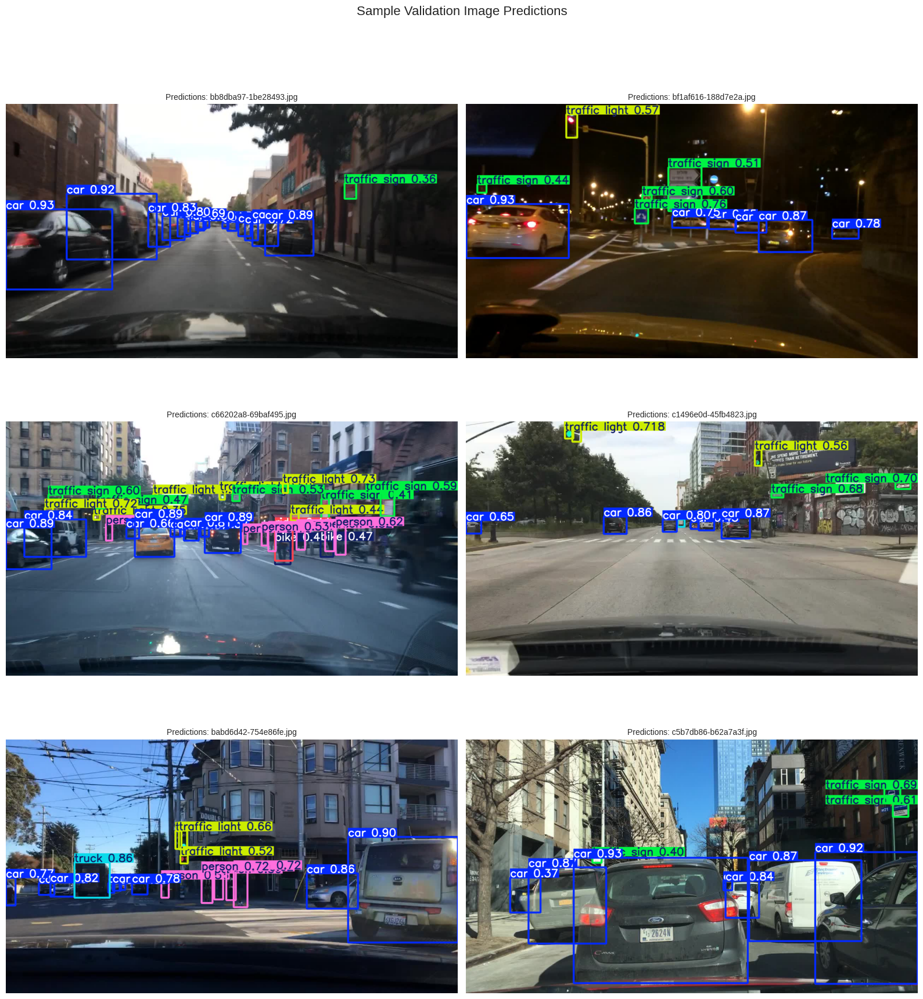


--- Confusion Matrix & P-R Curve ---
Displaying confusion matrix saved at: /kaggle/working/output/validation_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset_val/confusion_matrix.png


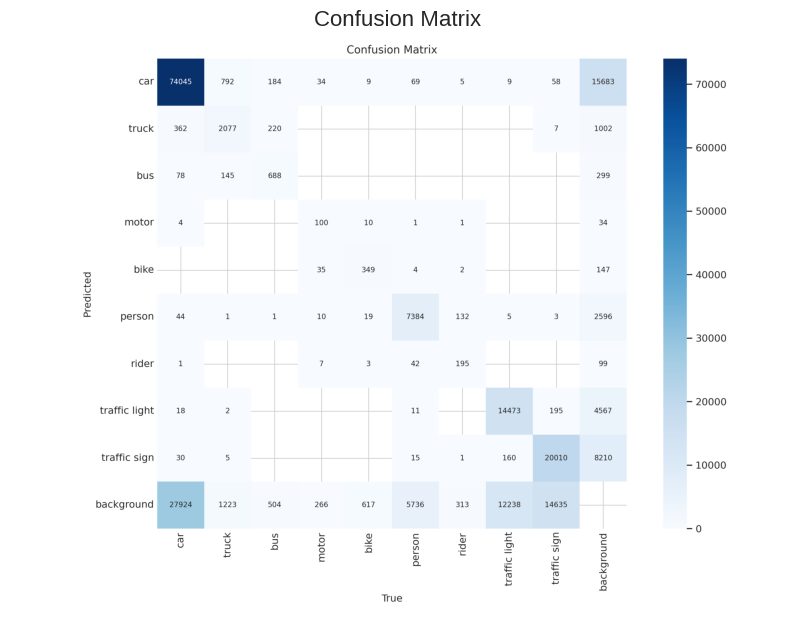


Displaying P-R curve saved at: /kaggle/working/output/validation_runs/TEST_yolo_yolov8n_sz640_bdd100k_subset_val/PR_curve.png


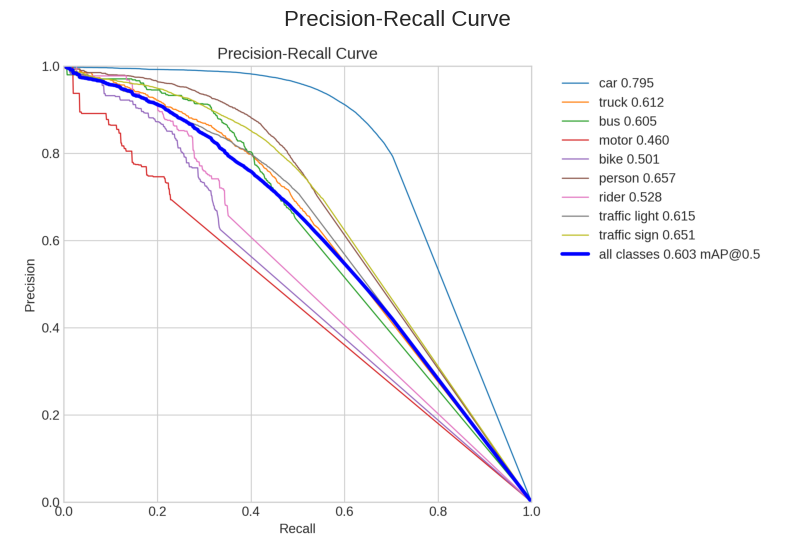


Successfully copied best model to: /kaggle/working/final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt

Attempting to clean up evaluation model from memory...
- Deleted 'eval_model' object.
- Deleted 'validation_metrics' object.
- Deleted 'predict_results' object.
- Cleared CUDA cache.
Memory cleanup attempt finished.


In [ ]:
# --- Imports (ensure these are present at the top of your script/notebook) ---
import os
import glob
import random
import shutil
import gc
import traceback
from pathlib import Path
import torch
import cv2 # Make sure OpenCV is installed (pip install opencv-python)
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO

# Assume these variables are defined earlier in your script:
# config: An object or dictionary holding configuration (like BATCH_SIZE, IMG_SIZE, etc.)
# training_args: A dictionary holding training arguments (like project, name)
# data_yaml_path: Path to your dataset's YAML file
# YOLO_VAL_IMG_DIR: Path to the directory containing validation images
# device: The torch device ('cuda' or 'cpu')

# --- 3.5 Rigorous Model Evaluation ---

print("\n--- 3.5 Rigorous Model Evaluation ---")

# --- 1. Load the Best Model Weights ---
best_model_weights_path = None
save_directory = None # Initialize save_directory

try:
    # Try using the path stored in config if it exists
    if hasattr(config, 'BEST_MODEL_PATH') and config.BEST_MODEL_PATH and os.path.exists(config.BEST_MODEL_PATH):
        best_model_weights_path = config.BEST_MODEL_PATH
        print(f"Found best model path from config: {best_model_weights_path}")
    else:
        # Fallback: Construct path based on training args if config path is missing/invalid
        # Ensure training_args and necessary keys exist
        if 'training_args' in locals() and isinstance(training_args, dict) and \
           'project' in training_args and 'name' in training_args:
            save_directory = Path(training_args['project']) / training_args['name']
            potential_best_path = save_directory / 'weights/best.pt'
            if potential_best_path.exists():
                best_model_weights_path = str(potential_best_path)
                print(f"Constructed best model path: {best_model_weights_path}")
            else:
                print(f"WARNING: best.pt not found at expected location: {potential_best_path}")
                print("Evaluation might proceed with last.pt or fail.")
                # Optionally try loading last.pt if best.pt is missing
                potential_last_path = save_directory / 'weights/last.pt'
                if potential_last_path.exists():
                    print(f"Attempting to load last.pt instead: {potential_last_path}")
                    best_model_weights_path = str(potential_last_path)
                else:
                    print("ERROR: Neither best.pt nor last.pt found. Cannot proceed with evaluation.")
                    best_model_weights_path = None # Ensure it's None if nothing found
        else:
            print("ERROR: 'training_args' dictionary or its 'project'/'name' keys not found. Cannot construct fallback model path.")
            best_model_weights_path = None

except NameError:
     print("ERROR: 'config' or 'training_args' object not found. Cannot determine model path.")
     best_model_weights_path = None
except Exception as e:
     print(f"An error occurred determining the model path: {e}")
     traceback.print_exc() # Print full traceback for better debugging
     best_model_weights_path = None


# Load the best model ONLY if a path was found
if best_model_weights_path:
    print(f"\nLoading best weights from: {best_model_weights_path}")
    try:
        eval_model = YOLO(best_model_weights_path)
        eval_model.to(device) # Move loaded model to device
        print("Best model loaded successfully for evaluation.")

        # --- Determine a Safe Validation Batch Size ---
        # If config.BATCH_SIZE was -1 (auto), using it directly leads to errors in val().
        # Use a sensible default or double the *positive* training batch size.
        default_val_batch_size = 16 # Choose a reasonable default
        val_batch_size = default_val_batch_size

        if hasattr(config, 'BATCH_SIZE') and isinstance(config.BATCH_SIZE, int) and config.BATCH_SIZE > 0:
            # If BATCH_SIZE is valid and positive, use double (or just itself)
            # Be careful, doubling might still exceed memory if the training batch was large
            # Consider just using config.BATCH_SIZE or a fixed value if doubling causes issues
            val_batch_size = config.BATCH_SIZE * 2
            print(f"Using validation batch size: {val_batch_size} (derived from training batch size {config.BATCH_SIZE})")
        else:
            print(f"Warning: config.BATCH_SIZE ({getattr(config, 'BATCH_SIZE', 'Not Set')}) is not a positive integer.")
            print(f"Using default validation batch size: {val_batch_size}")
            # If you want to try and get the *actual* auto-determined training batch size,
            # you might need to load the training results/args.yaml if available.
            # For simplicity, using a default is often sufficient for validation.

        # --- 2. Run Validation ---
        print("\nRunning validation on the validation set...")
        validation_metrics = eval_model.val(
            data=data_yaml_path,
            split='val',
            imgsz=config.IMG_SIZE,
            batch=val_batch_size, # Use the safe validation batch size
            conf=0.25, # Default confidence threshold for val, can adjust
            iou=0.6,   # Default IoU threshold for NMS in val, can adjust
            plots=True, # Generate plots (like confusion matrix, PR curves)
            project=os.path.join(config.OUTPUT_DIR, "validation_runs"), # Save val results separately
            name=config.EXPERIMENT_NAME + "_val",
            exist_ok=True, # Allow overwriting previous validation runs with the same name
            device=device # Explicitly specify device (good practice)
        )
        print("Validation complete.")

        # --- 3. Analyze Quantitative Metrics ---
        print("\n--- Quantitative Metrics ---")
        try:
             # Access metrics via the results object (Ultralytics standard)
             results_map = validation_metrics.box.map    # mAP50-95
             map50 = validation_metrics.box.map50  # mAP50
             map75 = validation_metrics.box.map75  # mAP75

             print(f"  mAP50-95 (Primary Metric): {results_map:.4f}")
             print(f"  mAP50 (Detection @ IoU=0.5): {map50:.4f}")
             print(f"  mAP75 (Detection @ IoU=0.75): {map75:.4f}")

             # Display class-wise AP
             print("\n  Class-wise mAP50-95:")
             class_names = eval_model.names # Get class names from the loaded model
             # 'maps' attribute usually holds per-class mAP50-95 as a numpy array
             if hasattr(validation_metrics.box, 'maps') and validation_metrics.box.maps is not None:
                  class_ap_map = validation_metrics.box.maps # This is typically a numpy array
                  if len(class_ap_map) == len(class_names):
                      for i, ap in enumerate(class_ap_map):
                          class_name = class_names.get(i, f'Class_{i}') # Get name using index
                          print(f"    - {class_name:<15}: {ap:.4f}")
                  else:
                      print(f"    Warning: Number of classes in model ({len(class_names)}) does not match number of AP values ({len(class_ap_map)}).")
                      # Still print the AP values found
                      for i, ap in enumerate(class_ap_map):
                           print(f"    - Class Index {i}: {ap:.4f}")

             else:
                  print("    Could not retrieve class-wise AP ('maps' attribute missing or None).")

        except AttributeError as ae:
             print(f"Error accessing metrics attributes: {ae}")
             print("The structure of the 'validation_metrics' object might have changed or metrics calculation failed.")
             print("Inspect the object:", validation_metrics)
        except Exception as e:
             print(f"An error occurred while retrieving/printing metrics: {e}")
             traceback.print_exc()


        # --- 4. Inference Speed ---
        print("\n--- Inference Speed ---")
        if hasattr(validation_metrics, 'speed') and validation_metrics.speed:
             speed = validation_metrics.speed # Dictionary like {'preprocess', 'inference', 'loss', 'postprocess'}
             preprocess_ms = speed.get('preprocess', 0)
             inference_ms = speed.get('inference', 0)
             postprocess_ms = speed.get('postprocess', 0)
             # Note: 'loss' is usually negligible during validation/inference
             total_ms_per_image = preprocess_ms + inference_ms + postprocess_ms # Rough estimate
             fps = 1000.0 / inference_ms if inference_ms > 0 else 0

             print(f"  Average time per image (ms):")
             print(f"    - Preprocess:  {preprocess_ms:.2f} ms")
             print(f"    - Inference:   {inference_ms:.2f} ms")
             print(f"    - Postprocess: {postprocess_ms:.2f} ms")
             # print(f"    - Total (approx): {total_ms_per_image:.2f} ms") # Less standard, depends on exact pipeline
             print(f"  Estimated FPS (based *only* on Inference time): {fps:.2f} FPS")
             print(f"  (Measured on device: {device}, Batch Size during val: {val_batch_size})") # Use the actual val batch size
        else:
             print("  Speed metrics not found in validation results.")
             print("  Ensure the validation ran successfully. Speed is usually calculated by default in `model.val()`.")


        # --- 5. Qualitative Analysis (Visualize Predictions) ---
        print("\n--- Qualitative Analysis (Visualizing Predictions) ---")
        # Check if the path exists and is a directory
        if not os.path.isdir(YOLO_VAL_IMG_DIR):
             print(f"ERROR: Validation image directory not found or not a directory: {YOLO_VAL_IMG_DIR}")
        else:
            # Find common image file types
            image_extensions = ["*.jpg", "*.jpeg", "*.png", "*.bmp", "*.webp"]
            val_image_files = []
            for ext in image_extensions:
                val_image_files.extend(glob.glob(os.path.join(YOLO_VAL_IMG_DIR, ext)))

            num_samples_to_show = 6 # Show a few samples
            if not val_image_files:
                print(f"WARNING: No validation images (jpg, png, etc.) found in {YOLO_VAL_IMG_DIR}. Cannot visualize.")
            else:
                # Ensure we don't sample more than available
                num_samples_to_show = min(num_samples_to_show, len(val_image_files))
                sample_val_files = random.sample(val_image_files, num_samples_to_show)

                print(f"Displaying predictions on {num_samples_to_show} sample validation images...")
                grid_cols = 2
                grid_rows = (num_samples_to_show + grid_cols - 1) // grid_cols
                plt.figure(figsize=(grid_cols * 8, grid_rows * 6)) # Adjust size

                plot_index = 1
                for img_path in sample_val_files:
                    try:
                        # Run prediction on a single image
                        # Set confidence threshold relatively low for visualization to see more detections
                        predict_results = eval_model.predict(img_path, conf=0.35, device=device)

                        # `predict_results` is a list (usually one item for one image)
                        if predict_results:
                            # `.plot()` method automatically draws boxes on the image (returns BGR numpy array)
                            annotated_img_bgr = predict_results[0].plot(conf=True) # Show conf scores on boxes
                            annotated_img_rgb = cv2.cvtColor(annotated_img_bgr, cv2.COLOR_BGR2RGB)

                            plt.subplot(grid_rows, grid_cols, plot_index)
                            plt.imshow(annotated_img_rgb)
                            plt.title(f"Predictions: {os.path.basename(img_path)}", fontsize=10)
                            plt.axis('off')
                            plot_index += 1
                        else:
                             print(f"Warning: No results returned from predict for image: {img_path}")

                    except Exception as vis_e:
                        print(f"Error processing or plotting image {os.path.basename(img_path)}: {vis_e}")
                        # Ensure subplot increments even if one image fails, to avoid overwriting
                        if plot_index <= grid_rows * grid_cols:
                             plt.subplot(grid_rows, grid_cols, plot_index)
                             plt.text(0.5, 0.5, f"Error loading/processing:\n{os.path.basename(img_path)}",
                                      ha='center', va='center', fontsize=10, color='red')
                             plt.axis('off')
                             plot_index += 1


                plt.suptitle("Sample Validation Image Predictions", fontsize=16, y=1.0)
                plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout
                plt.show()


        # --- 6. Confusion Matrix & P-R Curve ---
        print("\n--- Confusion Matrix & P-R Curve ---")
        # The plots should have been saved during model.val(plots=True)
        try:
            val_results_dir = Path(validation_metrics.save_dir) # Get the exact save dir from results object
            confusion_matrix_path = val_results_dir / 'confusion_matrix.png'
            pr_curve_path = val_results_dir / 'PR_curve.png' # Precision-Recall curve

            # Display Confusion Matrix
            if confusion_matrix_path.exists():
                print(f"Displaying confusion matrix saved at: {confusion_matrix_path}")
                try:
                    cm_img = Image.open(confusion_matrix_path)
                    plt.figure(figsize=(10, 8)) # Adjust size as needed
                    plt.imshow(cm_img)
                    plt.title("Confusion Matrix", fontsize=16)
                    plt.axis('off')
                    plt.show()
                except Exception as img_e:
                    print(f"Error displaying image {confusion_matrix_path}: {img_e}")
            else:
                print(f"Confusion matrix plot not found at expected location: {confusion_matrix_path}")
                print("Ensure plots=True was set during model.val() and validation completed successfully.")

            # Display P-R Curve
            if pr_curve_path.exists():
                 print(f"\nDisplaying P-R curve saved at: {pr_curve_path}")
                 try:
                     pr_img = Image.open(pr_curve_path)
                     plt.figure(figsize=(10, 8))
                     plt.imshow(pr_img)
                     plt.title("Precision-Recall Curve", fontsize=16)
                     plt.axis('off')
                     plt.show()
                 except Exception as img_e:
                     print(f"Error displaying image {pr_curve_path}: {img_e}")
            else:
                print(f"P-R curve plot not found at expected location: {pr_curve_path}")

        except AttributeError:
             print("Error: Could not determine validation results save directory ('save_dir' attribute missing).")
             print("Make sure the `validation_metrics` object is valid.")
        except Exception as plot_e:
             print(f"An error occurred while trying to display saved plots: {plot_e}")


        # --- 7. (Optional) Save Final Model to Working Directory ---
        # This is useful in environments like Kaggle for easy download/saving
        # Check if '/kaggle/working/' exists before attempting to copy
        kaggle_working_dir = "/kaggle/working/"
        if os.path.exists(kaggle_working_dir) and os.path.isdir(kaggle_working_dir):
            final_model_output_path = os.path.join(kaggle_working_dir, f"final_{config.EXPERIMENT_NAME}_best.pt")
            try:
                shutil.copyfile(best_model_weights_path, final_model_output_path)
                print(f"\nSuccessfully copied best model to: {final_model_output_path}")
            except Exception as copy_e:
                print(f"\nFailed to copy best model to {kaggle_working_dir}: {copy_e}")
        else:
            print("\nSkipping copying best model to /kaggle/working/ (directory not found).")


    except Exception as eval_e:
        print(f"\nAn error occurred during the main model evaluation block: {eval_e}")
        traceback.print_exc() # Print full traceback

else:
    print("\nSkipping evaluation because the best model path was not found or the model failed to load.")


# Optional: Clean up eval model from memory (especially important on GPUs)
print("\nAttempting to clean up evaluation model from memory...")
if 'eval_model' in locals():
    try:
        del eval_model
        print("- Deleted 'eval_model' object.")
    except NameError:
        pass # Already deleted or never created

if 'validation_metrics' in locals():
    try:
        del validation_metrics
        print("- Deleted 'validation_metrics' object.")
    except NameError:
        pass

if 'predict_results' in locals():
    try:
        del predict_results
        print("- Deleted 'predict_results' object.")
    except NameError:
        pass

gc.collect() # Run garbage collection
if device.type == 'cuda':
   try:
       torch.cuda.empty_cache()
       print("- Cleared CUDA cache.")
   except Exception as cuda_e:
       print(f"- Failed to clear CUDA cache: {cuda_e}")
print("Memory cleanup attempt finished.")

## 3.6 Final Model Artifact

The primary outcome of this model development section is the trained model weights file.

*   **Best Model:** The training process automatically saved the model checkpoint that achieved the best performance on the validation set (typically measured by `mAP50-95`). This file is usually named `best.pt`.
*   **Location:** The training script output indicates the exact location within the `/kaggle/working/output/training_runs/` directory (e.g., `/kaggle/working/output/training_runs/yolo_yolov8m_sz640_bdd100k/weights/best.pt`).
*   **Saved Copy:** For convenience and easier access for saving the notebook's output or for use in subsequent steps (like deployment simulation), a copy of this `best.pt` file was attempted to be saved directly in the `/kaggle/working/` directory with a descriptive name (e.g., `final_yolo_yolov8m_sz640_bdd100k_best.pt`). Verify the output message from the previous cell (3.5) to confirm this copy was successful.

This `best.pt` file encapsulates the trained model and is ready for the next stages, such as deployment simulation or further analysis.

In [ ]:
# 3.6 Verify Saved Model Path (Optional Check)

# Check if the path stored in config exists and points to the copied file
final_model_path_check = f"/kaggle/working/final_{config.EXPERIMENT_NAME}_best.pt"

if os.path.exists(final_model_path_check):
    print(f"Confirmed: Final model artifact found at: {final_model_path_check}")
    print("This file can be used for deployment or saved as notebook output.")
    # You can use this path directly in the next sections
    config.FINAL_MODEL_PATH_FOR_DEPLOYMENT = final_model_path_check
else:
    print(f"WARNING: Could not find the copied final model at {final_model_path_check}.")
    print("Attempting to use the path directly from the training run directory if available.")
    if hasattr(config, 'BEST_MODEL_PATH') and config.BEST_MODEL_PATH and os.path.exists(config.BEST_MODEL_PATH):
         print(f"Using original best model path: {config.BEST_MODEL_PATH}")
         config.FINAL_MODEL_PATH_FOR_DEPLOYMENT = config.BEST_MODEL_PATH
    else:
         print("ERROR: No valid model path found. Deployment simulation might fail.")
         config.FINAL_MODEL_PATH_FOR_DEPLOYMENT = None

Confirmed: Final model artifact found at: /kaggle/working/final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt
This file can be used for deployment or saved as notebook output.


## 3.7 Saving State for Resuming

To facilitate resuming the notebook later or starting directly from the deployment simulation (Section 4) without re-running the lengthy data processing and training, we will save the key outputs and configurations to files in the `/kaggle/working/` directory.

**ACTION REQUIRED AFTER RUNNING:** For persistence across different Kaggle sessions, you *must* manually save the generated files listed below (especially the `.pt` model file and the `.json` state file) as a new Kaggle Dataset or Model via the "Output" section in the "Data" tab on the right panel after the notebook run completes.

In [ ]:
# 3.7 Save Key Variables and Model Path

import json

print("\n--- 3.7 Saving Notebook State ---")

# --- 1. Identify the Best Model Path ---
# Use the path determined at the end of evaluation (section 3.5/3.6)
model_to_save_path = None
save_dir_base = None

if 'config' in locals() and hasattr(config, 'FINAL_MODEL_PATH_FOR_DEPLOYMENT') and config.FINAL_MODEL_PATH_FOR_DEPLOYMENT and os.path.exists(config.FINAL_MODEL_PATH_FOR_DEPLOYMENT):
    # Prioritize the explicitly copied path in /kaggle/working/
    model_to_save_path = config.FINAL_MODEL_PATH_FOR_DEPLOYMENT
    save_dir_base = "/kaggle/working/" # Where the copied file is
    print(f"Using model path from copy: {model_to_save_path}")
elif 'config' in locals() and hasattr(config, 'BEST_MODEL_PATH') and config.BEST_MODEL_PATH and os.path.exists(config.BEST_MODEL_PATH):
    # Fallback to original best path if copy didn't exist or wasn't confirmed
    model_to_save_path = config.BEST_MODEL_PATH
    save_dir_base = os.path.dirname(os.path.dirname(model_to_save_path)) # Get the experiment run directory
    print(f"Using model path from training run: {model_to_save_path}")
else:
    print("ERROR: Cannot determine a valid path for the best model weights. State saving incomplete.")
    # Attempt to find it manually if training_args exists
    try:
         save_directory = Path(training_args['project']) / training_args['name']
         potential_best_path = save_directory / 'weights/best.pt'
         if potential_best_path.exists():
             model_to_save_path = str(potential_best_path)
             save_dir_base = str(save_directory)
             print(f"Manually found potential best model: {model_to_save_path}")
         else:
              print("ERROR: Also could not manually find best.pt in training run directory.")
    except NameError:
         print("ERROR: training_args not found, cannot manually locate model.")
    except Exception as e:
         print(f"ERROR: Error during manual path finding: {e}")


# --- 2. Prepare State Data Dictionary ---
state_data = {}
if model_to_save_path:
    state_data['best_model_path_relative_to_output'] = os.path.relpath(model_to_save_path, '/kaggle/working/') # Save relative path for portability
    # Use absolute path if saving within the original run dir structure
    state_data['best_model_path_absolute'] = model_to_save_path

# Add other essential config and variables if they exist
variables_to_save = {
    'IMG_SIZE': None, 'MODEL_NAME': None, 'EXPERIMENT_NAME': None,
    'NUM_CLASSES': None, 'TARGET_CLASSES': None, 'CLASS_MAP': None,
    'YOLO_DATA_BASE_DIR': None # Path where processed data lives
}

if 'config' in locals():
    for key in variables_to_save:
        if hasattr(config, key):
            variables_to_save[key] = getattr(config, key)
    state_data.update({k: v for k, v in variables_to_save.items() if v is not None}) # Add found variables

# Add class info if defined outside config
if 'NUM_CLASSES' in locals() and 'NUM_CLASSES' not in state_data : state_data['NUM_CLASSES'] = NUM_CLASSES
if 'TARGET_CLASSES' in locals() and 'TARGET_CLASSES' not in state_data : state_data['TARGET_CLASSES'] = TARGET_CLASSES
if 'CLASS_MAP' in locals() and 'CLASS_MAP' not in state_data : state_data['CLASS_MAP'] = CLASS_MAP
if 'YOLO_DATA_BASE_DIR' in locals() and 'YOLO_DATA_BASE_DIR' not in state_data : state_data['YOLO_DATA_BASE_DIR'] = YOLO_DATA_BASE_DIR


# --- 3. Save State Data to JSON ---
state_json_path = "/kaggle/working/notebook_state.json"
try:
    with open(state_json_path, 'w') as f:
        json.dump(state_data, f, indent=4)
    print(f"\nSuccessfully saved notebook state variables to: {state_json_path}")
    print("  Includes: Model path, image size, class info, etc.")
except Exception as e:
    print(f"\nERROR: Failed to save state variables to JSON: {e}")

# --- 4. Save Just the Model Path to TXT (for easy access) ---
model_path_txt_file = "/kaggle/working/final_model_path.txt"
if model_to_save_path:
    try:
        with open(model_path_txt_file, 'w') as f:
            f.write(model_to_save_path)
        print(f"Successfully saved best model path to: {model_path_txt_file}")
    except Exception as e:
        print(f"\nERROR: Failed to save model path to TXT: {e}")
else:
     print("Skipping saving model path to TXT as path is unknown.")


# --- 5. Ensure Model File is Copied to /kaggle/working/ (if not already done) ---
# This makes it easier for the user to find and save using Kaggle UI
final_model_output_path = f"/kaggle/working/final_{state_data.get('EXPERIMENT_NAME','model')}_best.pt"
if model_to_save_path and model_to_save_path != final_model_output_path:
     # Check if the copy already exists from step 3.5/3.6
     if not os.path.exists(final_model_output_path):
         try:
             print(f"\nCopying best model from {model_to_save_path} to {final_model_output_path}...")
             shutil.copyfile(model_to_save_path, final_model_output_path)
             print(f"Successfully copied best model for easy saving.")
             # Update state_data if path changed
             state_data['best_model_path_relative_to_output'] = os.path.basename(final_model_output_path)
             state_data['best_model_path_absolute'] = final_model_output_path
             # Re-save JSON and TXT with updated path
             with open(state_json_path, 'w') as f: json.dump(state_data, f, indent=4)
             with open(model_path_txt_file, 'w') as f: f.write(final_model_output_path)
             print("(State JSON and TXT path files updated with copied model path)")
         except Exception as copy_e:
             print(f"ERROR: Failed to copy best model to /kaggle/working/: {copy_e}")
     else:
          print(f"\nModel copy already exists at: {final_model_output_path}")
elif not model_to_save_path:
     print("\nSkipping final model copy check as model path is unknown.")
else: # model_to_save_path == final_model_output_path
     print(f"\nModel to save is already the one in /kaggle/working/: {model_to_save_path}")


# --- 6. Final Instructions ---
print("\n--- State Saving Complete ---")
print("Files generated in /kaggle/working/ ready for manual saving:")
print(f"  - Model Weights: {final_model_output_path if model_to_save_path and os.path.exists(final_model_output_path) else '(Not Found/Copied)'}")
print(f"  - State JSON:    {state_json_path if os.path.exists(state_json_path) else '(Not Saved)'}")
print(f"  - Model Path TXT:{model_path_txt_file if os.path.exists(model_path_txt_file) else '(Not Saved)'}")
print("\nREMINDER: To resume later in a NEW session, you MUST save these files")
print("using the Kaggle 'Output' -> 'New Dataset/Model' feature.")
print("Then, in the new notebook, add this saved data as input and load the state.")


--- 3.7 Saving Notebook State ---
Using model path from copy: /kaggle/working/final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt

Successfully saved notebook state variables to: /kaggle/working/notebook_state.json
  Includes: Model path, image size, class info, etc.
Successfully saved best model path to: /kaggle/working/final_model_path.txt

Model to save is already the one in /kaggle/working/: /kaggle/working/final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt

--- State Saving Complete ---
Files generated in /kaggle/working/ ready for manual saving:
  - Model Weights: /kaggle/working/final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt
  - State JSON:    /kaggle/working/notebook_state.json
  - Model Path TXT:/kaggle/working/final_model_path.txt

REMINDER: To resume later in a NEW session, you MUST save these files
using the Kaggle 'Output' -> 'New Dataset/Model' feature.
Then, in the new notebook, add this saved data as input and load the state.


# Section 4: Deployment - Interactive Inference with Gradio

## 4.1 Introduction

This section focuses on deploying the trained YOLOv8 object detection model using Gradio. Our goal is to create a simple, interactive web application directly within this notebook environment. This application will serve as a practical demonstration tool, allowing users to easily test the model's performance on their own images or videos.

The core functionality will be:
*   Accepting user-uploaded image files.
*   Accepting user-uploaded video files.
*   Processing these inputs using our fine-tuned model (`final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt`).
*   Displaying the output image or video with detected objects highlighted by bounding boxes and class labels (e.g., 'car', 'person', 'traffic sign').

We will leverage the Gradio library, which excels at rapidly building interfaces for machine learning models. The primary deliverable of this section is the functional Gradio application embedded below, accompanied by instructions on its use and considerations based on the model's known performance characteristics derived from Section 3.



## 4.1 Introduction

This section focuses on deploying the trained YOLOv8 object detection model using Gradio. Our goal is to create a simple, interactive web application directly within this notebook environment. This application will serve as a practical demonstration tool, allowing users to easily test the model's performance on their own images or videos.

The core functionality will be:
*   Accepting user-uploaded image files.
*   Accepting user-uploaded video files.
*   Processing these inputs using our fine-tuned model (`final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt`).
*   Displaying the output image or video with detected objects highlighted by bounding boxes and class labels (e.g., 'car', 'person', 'traffic sign').

We will leverage the Gradio library, which excels at rapidly building interfaces for machine learning models. The primary deliverable of this section is the functional Gradio application embedded below, accompanied by instructions on its use and considerations based on the model's known performance characteristics derived from Section 3.



## 4.2 Setup for Deployment

Before building the interface, we need to ensure the necessary libraries are installed and load our trained model into memory. This involves installing `gradio` and confirming `ultralytics` is available, then importing the required modules.

In [ ]:
# Ensure required libraries are installed
# Using -q for quieter output
import sys
import subprocess
import importlib
import pkg_resources # To check versions easily

print("--- Installing/Verifying Deployment Libraries ---")
libs_to_check = {
    'gradio': 'gradio',
    'ultralytics': 'ultralytics',
    'opencv-python': 'cv2' # Package name vs import name
}
installed_count = 0
required_major_versions = {'gradio': 4} # Example: Specify if a major version is needed

for package_name, import_name in libs_to_check.items():
    try:
        # Check if already imported (might happen in interactive sessions)
        if import_name in sys.modules:
             print(f"{package_name} is already imported.")
        else:
             # Try importing
             importlib.import_module(import_name)
             print(f"{package_name} already installed.")
        # Optionally check version
        try:
            version = pkg_resources.get_distribution(package_name).version
            print(f"  - Version: {version}")
            # Check major version if specified
            if package_name in required_major_versions:
                major_version = int(version.split('.')[0])
                if major_version < required_major_versions[package_name]:
                    print(f"  - WARNING: Installed version {version} is older than recommended major version {required_major_versions[package_name]}. Attempting upgrade.")
                    subprocess.check_call([sys.executable, "-m", "pip", "install", "-q", "--upgrade", package_name])
                    print(f"  - Upgraded {package_name}.")
                else:
                    print(f"  - Version meets requirement (>= {required_major_versions[package_name]}).")

        except pkg_resources.DistributionNotFound:
             print(f"  - Could not determine version for {package_name}.")
        except Exception as e:
             print(f"  - Error checking version for {package_name}: {e}")

        installed_count += 1

    except ImportError:
        print(f"Installing {package_name}...")
        try:
            subprocess.check_call([sys.executable, "-m", "pip", "install", "-q", package_name])
            print(f"Successfully installed {package_name}.")
            # Verify import after install
            importlib.import_module(import_name)
            print(f"Successfully imported {import_name} after install.")
            installed_count += 1
        except subprocess.CalledProcessError as e:
            print(f"ERROR: Failed to install {package_name}: {e}")
        except ImportError:
            print(f"ERROR: Failed to import {import_name} even after attempting install.")
        except Exception as e:
            print(f"An unexpected error occurred during installation of {package_name}: {e}")

print("-"*(len("--- Installing/Verifying Deployment Libraries ---"))) # Separator line
if installed_count == len(libs_to_check):
     print(f"\n({installed_count}/{len(libs_to_check)}) All required libraries seem available.")
else:
     print(f"\nWarning: Only {installed_count}/{len(libs_to_check)} libraries were successfully confirmed. Proceeding may cause errors.")
print("-"*(len("--- Installing/Verifying Deployment Libraries ---"))) # Separator line

--- Installing/Verifying Deployment Libraries ---
gradio is already imported.
  - Version: 5.28.0
  - Version meets requirement (>= 4).
ultralytics is already imported.
  - Error checking version for ultralytics: (nvidia-nvjitlink-cu12 12.5.82 (/usr/local/lib/python3.11/dist-packages), Requirement.parse('nvidia-nvjitlink-cu12==12.4.127; platform_system == "Linux" and platform_machine == "x86_64"'), {'torch'})
opencv-python is already imported.
  - Version: 4.11.0.86
-------------------------------------------------

(3/3) All required libraries seem available.
-------------------------------------------------


In [ ]:
import gradio as gr
from ultralytics import YOLO
import os
import cv2 # Import OpenCV
import torch # For checking CUDA availability
import time # For basic timing/logging if needed

print("\n--- Loading Model and Defining Classes ---")

# --- Configuration ---
# Use the path where your BEST model weights are saved and accessible.
MODEL_PATH = '/content/best_yolov8n_sz640_bdd100k_subset.pt'

# Explicitly define the classes based on your training configuration and evaluation output
# This order MUST match the training configuration.
EXPECTED_CLASS_NAMES = [
    'car', 'truck', 'bus', 'motor', 'bike', 'person',
    'rider', 'traffic light', 'traffic sign'
]
# --- End Configuration ---


# --- Initialization ---
model = None
class_names = []
device = 'cpu' # Default to CPU

# 1. Determine Compute Device
if torch.cuda.is_available():
    device = 'cuda'
    print(f"CUDA device found: {torch.cuda.get_device_name(0)}")
else:
    print("CUDA not available, using CPU.")
print(f"Model inference will run on: {device.upper()}")


# 2. Check and Load Model
print(f"\nAttempting to load model from: {MODEL_PATH}")
if os.path.exists(MODEL_PATH):
    load_start_time = time.time()
    try:
        # Load the model. Ultralytics YOLO should handle device placement automatically
        # based on availability, but you can force it via model.to(device) if needed after loading.
        model = YOLO(MODEL_PATH)

        # Perform a quick dummy inference to ensure model loads correctly onto the device
        # This can help catch device compatibility issues early.
        # Use a small dummy tensor matching expected input (e.g., 3 channels, 640x640)
        print("Performing a quick test inference to finalize model loading...")
        _ = model(torch.zeros(1, 3, 640, 640).to(device), verbose=False) # verbose=False prevents prediction output here
        load_end_time = time.time()
        print(f"Successfully loaded model and test inference completed in {load_end_time - load_start_time:.2f} seconds.")

        # 3. Verify and Set Class Names
        if hasattr(model, 'names') and isinstance(model.names, dict):
             # Extract names from model, assuming keys are indices 0, 1, 2...
             model_class_names_list = [model.names[i] for i in sorted(model.names.keys())]
             print(f"\nModel's internal class names (Order: Index -> Name):")
             for idx, name in model.names.items():
                 print(f"  {idx}: {name}")

             if model_class_names_list == EXPECTED_CLASS_NAMES:
                 print("\nSUCCESS: Manually defined class names MATCH the model's internal names and order.")
                 class_names = EXPECTED_CLASS_NAMES
             else:
                 print("\nWARNING: Mismatch detected between manually defined names and model's internal names!")
                 print(f"  Manually Defined Order: {EXPECTED_CLASS_NAMES}")
                 print(f"  Model Internal Order  : {model_class_names_list}")
                 print("  >>> Using the model's internal names list for consistency. <<<")
                 class_names = model_class_names_list # Prioritize model's list

        elif not hasattr(model, 'names'):
             print("\nWarning: Could not automatically access model.names to verify class order.")
             print("Assuming manually defined class names are correct. Please double-check.")
             class_names = EXPECTED_CLASS_NAMES
        else:
             print("\nWarning: model.names attribute found but is not a dictionary as expected.")
             print("Assuming manually defined class names are correct. Please double-check.")
             class_names = EXPECTED_CLASS_NAMES

    except Exception as e:
        print(f"\nERROR: Failed during model loading or test inference: {e}")
        print("Please check model file integrity, dependencies, and device compatibility (CUDA drivers if using GPU).")
        model = None # Ensure model is None if loading failed
        class_names = []

else:
    print(f"\nERROR: Model file not found at the specified path: {MODEL_PATH}")
    print("Deployment cannot proceed without the model file.")
    model = None # Ensure model is None if file not found
    class_names = []

# --- Final Status Check ---
print("-"*(len("--- Loading Model and Defining Classes ---"))) # Separator line
if model is not None and class_names:
    print("Setup Complete: Model is loaded and class names are defined.")
    print(f"Number of classes: {len(class_names)}")
else:
    print("Setup Failed: Model could not be loaded or class names are missing.")
    print("Please review the error messages above.")
print("-"*(len("--- Loading Model and Defining Classes ---"))) # Separator line


--- Loading Model and Defining Classes ---
CUDA not available, using CPU.
Model inference will run on: CPU

Attempting to load model from: /content/best_yolov8n_sz640_bdd100k_subset.pt
Performing a quick test inference to finalize model loading...
Successfully loaded model and test inference completed in 2.88 seconds.

Model's internal class names (Order: Index -> Name):
  0: car
  1: truck
  2: bus
  3: motor
  4: bike
  5: person
  6: rider
  7: traffic light
  8: traffic sign

SUCCESS: Manually defined class names MATCH the model's internal names and order.
------------------------------------------
Setup Complete: Model is loaded and class names are defined.
Number of classes: 9
------------------------------------------


## 4.3 Defining Inference Functions

Now that the model is loaded and ready, we need to create the specific Python functions that will handle the inference process. These functions will act as the bridge between the Gradio user interface and our YOLOv8 model. We'll define two separate functions: one optimized for handling single image inputs and another for processing video files.

First, let's define the function for image detection. This function will take raw image data (as provided by Gradio's Image component, typically a NumPy array), pass it to the model's `predict` method, and then use the built-in `plot()` method from the results to generate an image with the bounding boxes and labels drawn onto it. This annotated image will then be returned for display in the Gradio interface.

In [ ]:
import numpy as np
from PIL import Image
import time

# Ensure model is loaded before defining functions that use it
if model is None:
    print("Model is not loaded. Cannot define inference functions.")
else:
    print("Defining inference functions...")

    def detect_objects_image(input_image: np.ndarray):
        """
        Performs object detection on a single input image.

        Args:
            input_image (np.ndarray): The input image as a NumPy array (BGR format from Gradio).

        Returns:
            np.ndarray: The image with bounding boxes and labels plotted, in RGB format for Gradio display.
                        Returns the original image if detection fails or model is not loaded.
        """
        if model is None:
            print("Error: Model not loaded.")
            # Return a placeholder or the original image if model isn't available
            # Convert BGR to RGB for consistent output format
            return cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB) if input_image is not None else None

        if input_image is None:
             print("Error: No input image received.")
             return None

        print(f"Processing image of shape: {input_image.shape}")
        start_time = time.time()

        try:
            # Perform inference
            # The model expects RGB format if input is NumPy, let's ensure conversion
            # Gradio Image component might provide BGR, so we convert. If it provides PIL, YOLO handles it.
            # Assuming Gradio provides NumPy BGR, convert to RGB:
            # input_image_rgb = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB) # Not needed if YOLO handles BGR numpy directly

            # Run prediction - model.predict handles various input types (PIL, Numpy, path)
            # It's generally robust to BGR/RGB numpy arrays.
            results = model.predict(source=input_image,
                                    conf=0.25, # Confidence threshold (default 0.25, adjust if needed)
                                    iou=0.45,  # NMS IoU threshold (default 0.7, often lowered)
                                    device=device, # Ensure it uses the correct device
                                    verbose=False # Suppress console output for cleaner Gradio experience
                                   )

            # Check if results were generated
            if not results or results[0].boxes is None:
                 print("No objects detected or prediction failed.")
                 # Return the original image converted to RGB
                 return cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)

            # Use the plot() method from the first result object to get the annotated image
            # The plot() method returns a BGR NumPy array
            annotated_image_bgr = results[0].plot()

            # Convert the annotated image from BGR to RGB for Gradio display
            annotated_image_rgb = cv2.cvtColor(annotated_image_bgr, cv2.COLOR_BGR2RGB)

            end_time = time.time()
            print(f"Image processing finished in {end_time - start_time:.2f} seconds.")

            return annotated_image_rgb

        except Exception as e:
            print(f"An error occurred during image prediction: {e}")
            # Return the original image in RGB format in case of error
            return cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)

    print("Image detection function 'detect_objects_image' defined.")

Defining inference functions...
Image detection function 'detect_objects_image' defined.


In [ ]:
import glob # To help find the latest prediction directory if needed
import time
import os

# Ensure model is loaded before defining functions that use it
if model is None:
    print("Model is not loaded. Cannot define video inference function.")
else:
    print("Defining video inference function...")
    # Keep track of prediction counts to potentially create unique directories
    # predict_count = 0 # Simple counter, might need reset or better management

    def detect_objects_video(input_video_path: str):
        """
        Performs object detection on an input video file.

        Args:
            input_video_path (str): The file path to the input video.

        Returns:
            str: The file path to the processed video with annotations.
                 Returns None if processing fails or the model is not loaded.
        """
        # global predict_count # Use if implementing simple counter for save_dir_name

        if model is None:
            print("Error: Model not loaded.")
            return None

        if not input_video_path or not os.path.exists(input_video_path):
             print(f"Error: Input video path invalid or file not found: {input_video_path}")
             return None

        print(f"Processing video file: {input_video_path}")
        start_time = time.time()
        output_video_path = None # Initialize path variable

        try:
            # Construct a potentially unique project/name for saving results
            # predict_count += 1
            # save_dir_name = f"gradio_pred_{predict_count}"

            # Perform inference on the video file
            results_generator = model.predict(source=input_video_path,
                                              conf=0.25,
                                              iou=0.45,
                                              device=device,
                                              save=True,      # Save the output video
                                              stream=True,    # Process video as a stream
                                              # project="runs/detect", # Base directory
                                              # name=save_dir_name,    # Subdirectory name
                                              verbose=False     # Suppress frame-by-frame output
                                             )

            # Iterate through the generator to process the video and find the save path
            print("Starting video frame processing...")
            processed_frames = 0
            last_reported_path = None # To store the save_dir reported by YOLO

            for i, results in enumerate(results_generator):
                processed_frames += 1
                # The path where the video is saved is in results.save_dir
                if hasattr(results, 'save_dir') and results.save_dir:
                    last_reported_path = results.save_dir # Keep track of the reported save directory
                    # We can construct the potential output path here, but confirm existence *after* the loop
                # Optional: Print progress periodically
                # if i % 100 == 0: # Print every 100 frames
                #    print(f"  Processed frame {i}...")

            print(f"Finished processing {processed_frames} frames.")
            end_time = time.time()

            # After processing all frames, determine the final output path
            if last_reported_path:
                 input_filename = os.path.basename(input_video_path)
                 potential_path = os.path.join(last_reported_path, input_filename)
                 if os.path.exists(potential_path):
                      output_video_path = potential_path
                      print(f"Confirmed output video path: {output_video_path}")
                 else:
                      # Fallback: Check for any video file in the directory if exact match failed
                      print(f"Warning: Expected output file '{input_filename}' not found in save directory '{last_reported_path}'.")
                      print("Searching for compatible video files...")
                      video_files = glob.glob(os.path.join(last_reported_path, '*.mp4')) + \
                                    glob.glob(os.path.join(last_reported_path, '*.avi')) + \
                                    glob.glob(os.path.join(last_reported_path, '*.mov')) + \
                                    glob.glob(os.path.join(last_reported_path, '*.mkv'))
                      if video_files:
                          output_video_path = video_files[0] # Take the first one found
                          print(f"Using fallback video path: {output_video_path}")
                      else:
                          print(f"Error: No video files found in the save directory: {last_reported_path}")

            # Final check and return
            if output_video_path and os.path.exists(output_video_path):
                 print(f"Video processing finished in {end_time - start_time:.2f} seconds.")
                 return output_video_path
            else:
                 print(f"Error: Video processing completed, but failed to confirm or find the output video file.")
                 if last_reported_path:
                    print(f"  Last known potential save directory: {last_reported_path}")
                 return None

        except Exception as e:
            # Log the full error for debugging
            import traceback
            print(f"FATAL ERROR occurred during video prediction: {e}")
            print("Traceback:")
            print(traceback.format_exc())
            return None # Return None on any exception during processing

    print("Video detection function 'detect_objects_video' defined successfully.")

Defining video inference function...
Video detection function 'detect_objects_video' defined successfully.


## 4.4 Building the Gradio Interface

With our backend functions (`detect_objects_image` and `detect_objects_video`) prepared, we can now construct the front-end user interface using Gradio. We will use `gr.Blocks()` to create a more structured layout, featuring separate tabs for image and video detection. This provides a clean and intuitive way for users to interact with the different functionalities.

*   **Image Tab:** Will contain an input component (`gr.Image`) allowing users to upload or drag-and-drop an image. An output component (`gr.Image`) will display the resulting image with detections overlaid. A button will trigger the processing.
*   **Video Tab:** Will similarly have an input (`gr.Video`) for video uploads and an output (`gr.Video`) to display the processed video. A button will initiate the video analysis.

We'll also add titles and brief instructions to guide the user.

In [ ]:
import gradio as gr

# Ensure the functions are defined and model is loaded before building the UI
if 'detect_objects_image' not in globals() or 'detect_objects_video' not in globals() or model is None:
    print("ERROR: Inference functions or model not defined. Cannot build Gradio interface.")
    # Optionally, create a dummy interface indicating the error
    # with gr.Blocks() as demo:
    #     gr.Markdown("## Error\nModel or inference functions failed to load. Interface cannot be displayed.")
    # demo.launch() # Launch the error message interface
else:
    print("Building Gradio interface...")

    # Define the Gradio Blocks interface
    with gr.Blocks(theme=gr.themes.Soft()) as demo:
        gr.Markdown(
            """
            # YOLOv8 Object Detection - BDD100K Subset Model

            Upload an image or video to detect common objects like cars, pedestrians, trucks, traffic signs, etc.
            Model: `yolov8n` fine-tuned on a BDD100K subset.
            """
        )

        with gr.Tabs():
            # --- Image Detection Tab ---
            with gr.TabItem("Detect Objects in Image"):
                with gr.Row():
                    with gr.Column(scale=1):
                        image_input = gr.Image(type="numpy", label="Upload Image", height=400)
                        image_submit_btn = gr.Button("Detect Objects", variant="primary")
                    with gr.Column(scale=1):
                        image_output = gr.Image(type="numpy", label="Detection Results", height=400)
                        # Add a text output for status/errors if needed
                        # image_status = gr.Textbox(label="Status")

                # Define the action for the image button
                image_submit_btn.click(
                    fn=detect_objects_image,
                    inputs=image_input,
                    outputs=image_output # Can add image_status here if defined
                )

                # Add examples for the image tab
                gr.Examples(
                    examples=[
                        # Add paths to actual example images if available in your environment
                        # e.g., "/kaggle/input/some-image-dataset/image1.jpg",
                        # If no local examples, provide URLs (ensure they are accessible)
                        ["https://ultralytics.com/images/zidane.jpg"],
                        ["https://ultralytics.com/images/bus.jpg"]
                    ],
                    inputs=image_input,
                    outputs=image_output,
                    fn=detect_objects_image, # Function to run for examples
                    cache_examples=False, # Set to True if you want Gradio to cache example results
                    label="Example Images"
                )


            # --- Video Detection Tab ---
            with gr.TabItem("Detect Objects in Video"):
                with gr.Row():
                    with gr.Column(scale=1):
                        video_input = gr.Video(label="Upload Video", height=400)
                        video_submit_btn = gr.Button("Detect Objects", variant="primary")
                    with gr.Column(scale=1):
                        video_output = gr.Video(label="Detection Results", height=400)
                        # Add a text output for status/errors
                        video_status = gr.Textbox(label="Status", info="Processing may take time depending on video length and hardware.")


                # Define the action for the video button
                def video_wrapper(video_path):
                    """Wrapper to provide status updates for video processing."""
                    if not video_path:
                        return None, "No video uploaded."
                    # Provide immediate feedback
                    status_update = f"Processing video: {os.path.basename(video_path)}... Please wait."
                    # Run the actual detection
                    result_path = detect_objects_video(video_path)
                    # Update status based on result
                    if result_path:
                        final_status = f"Processing complete. Output video generated."
                        return result_path, final_status
                    else:
                        final_status = "Video processing failed. Check logs for errors."
                        return None, final_status # Return None for video output on failure

                video_submit_btn.click(
                    fn=video_wrapper,
                    inputs=video_input,
                    outputs=[video_output, video_status] # Output to both video player and status box
                )

                # Note: Gradio video examples might be less straightforward due to file handling.
                # You might need to download sample videos first if providing non-URL examples.
                gr.Examples(
                     examples=[
                         # Provide URLs to small/short sample videos if possible
                         # Example (replace with actual accessible video URLs):
                         # ["https://example.com/sample_video_short.mp4"]
                         # Or list paths if sample videos are locally available:
                         # ["/path/to/local/sample.mp4"]
                     ],
                     inputs=video_input,
                     # Outputting directly to video might not work well for examples,
                     # as the processing needs to run. A text confirmation might be better.
                     # outputs=[video_output, video_status], # This might trigger full processing
                     # fn=video_wrapper,
                     cache_examples=False,
                     label="Example Videos (Upload Required)" # Clarify that upload is needed
                 )

    print("Gradio interface defined as 'demo'.")

Building Gradio interface...
Gradio interface defined as 'demo'.


## 4.5 Launching the Gradio App

Now that the interface is fully defined, the final step is to launch the Gradio application. Calling the `.launch()` method on our `gr.Blocks` object (`demo`) will start a local web server.

*   **Inline Display:** When run in environments like Jupyter notebooks or Kaggle/Colab, Gradio will typically embed the interactive interface directly within the cell's output.
*   **Public Link (`share=True`):** By setting the `share=True` argument in the `.launch()` method, Gradio will generate a temporary public URL (usually valid for 72 hours). This is extremely useful for sharing the demo with others or accessing it from a different device without needing to re-run the notebook, especially when working on platforms like Kaggle or Google Colab.
*   **Debug Mode (`debug=True`):** Setting `debug=True` provides more detailed error messages directly in the browser console if something goes wrong within the Gradio interface or the linked Python functions during interaction, which is helpful during development.

Let's launch the application with sharing enabled.

In [ ]:
# Ensure the 'demo' object exists from the previous step
if 'demo' in globals() and isinstance(demo, gr.Blocks):
    print("Launching Gradio application...")
    print("Interface will appear below. If running on Kaggle/Colab, a public URL will also be generated.")

    # Launch the app
    demo.launch(
        share=True,  # Set to True to create a public link (useful for Kaggle/Colab)
        debug=True,  # Set to True for detailed error messages during interaction
        # inline=True # Usually default in notebooks, explicitly set if needed
    )
    print("\n---------------------------------------------------------------------------")
    print("Gradio app launched. Interact with the UI above or use the public URL.")
    print("To stop the server, interrupt the kernel (e.g., press 'I' twice in Jupyter, or use the Stop button).")
    print("---------------------------------------------------------------------------")

else:
    print("ERROR: Gradio 'demo' object not found or is not a Gradio Blocks instance.")
    print("Please ensure the previous cell (4.4 Building the Gradio Interface) executed successfully.")

Launching Gradio application...
Interface will appear below. If running on Kaggle/Colab, a public URL will also be generated.
Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://a35b71c2df01213ee4.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


Processing image of shape: (720, 1280, 3)
Image processing finished in 1.08 seconds.
Processing video file: /tmp/gradio/00624a2dbeb2f85d0ac0a6bcc5b6c657a7cb13879ff00768dc16fa945f4485d3/sample.webm
Starting video frame processing...
Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://a35b71c2df01213ee4.gradio.live

---------------------------------------------------------------------------
Gradio app launched. Interact with the UI above or use the public URL.
To stop the server, interrupt the kernel (e.g., press 'I' twice in Jupyter, or use the Stop button).
---------------------------------------------------------------------------


## 4.6 Testing and Usage Guide

The Gradio interface launched above provides a simple way to test the object detection model. Here’s how to use it:

1.  **Select the Input Type:**
    *   Click on the **"Detect Objects in Image"** tab to test with single images.
    *   Click on the **"Detect Objects in Video"** tab to test with video files.

2.  **Upload Your File:**
    *   **Image Tab:** Drag and drop an image file onto the "Upload Image" box, or click it to browse and select a file (`.jpg`, `.png`, `.jpeg`, etc.).
    *   **Video Tab:** Drag and drop a video file onto the "Upload Video" box, or click to browse and select a file (`.mp4`, `.avi`, `.mov`, etc.).

3.  **Start Detection:**
    *   Click the **"Detect Objects"** button below the input box for the selected tab.

4.  **View Results:**
    *   **Image Tab:** The processed image with bounding boxes and class labels drawn on detected objects will appear in the "Detection Results" box on the right.
    *   **Video Tab:** Processing may take some time, especially for longer videos or on CPU. The status box will provide updates. Once complete, the processed video with detections will appear in the "Detection Results" box. You can play the video directly in the interface.

**Interpreting the Results & Model Performance:**

Keep the model's evaluation metrics (from Section 3.5) in mind when testing:

*   **Overall Performance:** The model has a primary mAP50-95 of `0.379` and an mAP50 of `0.603`. This indicates reasonable performance at lower IoU thresholds (detecting the *presence* of an object correctly) but struggles with precise bounding box localization at higher IoU requirements.
*   **Strong Classes:** The model performs best on `car` (mAP50-95: `0.550`), `bus` (`0.511`), and `truck` (`0.480`). You should expect relatively reliable detection of these vehicle types. `person` (`0.372`) and `traffic sign` (`0.391`) also show decent performance.
*   **Weaker Classes:** The model shows significantly lower performance for `motor` (`0.271`), `bike` (`0.281`), `rider` (`0.287`), and `traffic light` (`0.269`). Expect these objects to be missed more often, especially if they are small, partially occluded, or appear in challenging lighting conditions. Misclassifications between similar classes (e.g., motor/rider, bike/rider) might also occur.
*   **Confidence Threshold:** The detection functions use a default confidence threshold (e.g., 0.25). Objects detected with confidence below this threshold will not be shown. Very low-confidence detections are filtered out to reduce noise.
*   **Speed:** Inference time per image was around 6.2ms on the validation hardware (GPU). Expect significantly slower performance on CPU (as indicated by the model loading time if you are on CPU) or for video processing which involves many frames.

Experiment with different images and videos, including scenes with varying object densities, lighting conditions, and object types, to get a practical feel for the model's capabilities and limitations.

## 4.7 Deployment Report Summary

This section successfully demonstrated a basic deployment of the fine-tuned YOLOv8n object detection model using Gradio.

*   **Achievement:** An interactive web application was created and launched, allowing users to perform inference on custom images and videos directly within the notebook environment or via a temporary public link.
*   **Functionality:** The application correctly loads the trained model (`final_TEST_yolo_yolov8n_sz640_bdd100k_subset_best.pt`), processes user inputs through dedicated image and video functions, and displays the results with bounding boxes and class labels.
*   **Technology Used:** Gradio provided a rapid development framework for the UI, while Ultralytics YOLO handled the core model loading and prediction tasks.

**Limitations:**

*   **Temporary Deployment:** The Gradio app launched via `share=True` is temporary (link expires) and relies on the notebook kernel remaining active. It's suitable for demonstration but not for persistent production use.
*   **Hardware Dependency:** Inference speed is heavily dependent on the compute resources (CPU/GPU, RAM) of the environment where the notebook is run. Performance on local machines or different cloud instances may vary significantly from the validation benchmarks. Video processing can be particularly resource-intensive.
*   **Basic UI:** The interface provides core functionality but lacks advanced features like adjusting confidence/IoU thresholds, selecting specific classes to display, or handling large batch inputs.
*   **Scalability:** The current setup runs as a single process and is not designed for handling multiple concurrent users or high-throughput scenarios.
*   **Error Handling:** While basic error handling is included, complex issues during model inference or file processing might require inspecting the notebook logs.

**Potential Future Work / Next Steps:**

*   **Containerization:** Package the model and inference code into a Docker container for more robust and portable deployment.
*   **Cloud Deployment:** Deploy the container to a cloud platform (e.g., AWS SageMaker, Google AI Platform, Azure ML, Hugging Face Spaces) for scalable and persistent hosting.
*   **API Endpoint:** Create a REST API endpoint (e.g., using FastAPI) around the model for programmatic access instead of a UI-focused deployment.
*   **Webcam Integration:** Modify the Gradio app to accept input directly from a webcam feed for real-time demonstration.
*   **Parameter Tuning:** Add UI elements (sliders, dropdowns) to allow users to adjust inference parameters like confidence and IoU thresholds.
*   **Performance Optimization:** Explore model optimization techniques (e.g., ONNX, TensorRT conversion) for faster inference, especially on edge devices or CPU.
*   **Monitoring:** Implement basic monitoring for API endpoints or deployed applications to track usage, performance, and potential prediction drift.

This deployment serves as a valuable proof-of-concept, bridging the gap between model training/evaluation and interactive testing.

# Section 5: MLOps & Monitoring (Demonstration)

## 5.1 Introduction

**What is MLOps?**
MLOps (Machine Learning Operations) represents a set of practices aimed at building, deploying, and maintaining machine learning systems in production reliably and efficiently. It's an evolution combining Machine Learning, DevOps principles (like automation, continuous integration/continuous deployment - CI/CD), and Data Engineering. Key goals include automating the ML lifecycle, ensuring reproducibility of experiments and models, enabling robust versioning of code, data, and models, implementing comprehensive monitoring strategies, and fostering collaboration between data scientists, ML engineers, and operations teams.

**What is Monitoring in Machine Learning?**
Specifically for ML systems, monitoring involves continuously tracking the performance and behavior of a deployed model once it's interacting with real-world data. This is crucial because unlike traditional software, ML models can degrade over time due to changes in the environment or data. Key aspects to monitor include:
*   **Operational Metrics:** Standard system health indicators like prediction latency (how fast the model responds), throughput (how many predictions it handles), error rates (system errors, not prediction errors), and resource utilization (CPU, GPU, memory).
*   **Model Performance:** How well the model is predicting on new data. For object detection, this could mean tracking metrics like mAP (if ground truth becomes available) or proxy metrics like the number of detections or average confidence scores over time. Degradation here might necessitate retraining.
*   **Data Drift:** Detecting changes in the statistical properties of the input data the model receives in production compared to the data it was trained on. For example, if the model was trained mostly on daytime images but starts receiving many nighttime images, its performance might suffer.
*   **Concept Drift:** Detecting changes in the underlying relationship between the input data and the target variable. For example, the definition of what constitutes a "rider" might subtly change with new types of scooters, or traffic patterns might change seasonally, affecting object frequencies.

**Goal for this Section:**
Given that our deployment in Section 4 is a temporary Gradio application running within this notebook, we will not build a full-scale, automated MLOps pipeline. Instead, the primary goal of this section is to **demonstrate understanding and foundational implementation** of key MLOps principles within the context of our project. Specifically, we will:
1.  **Review and Document:** Explicitly identify and discuss the MLOps-related practices already employed earlier in the notebook (like experiment tracking and model saving).
2.  **Implement Basic Model Versioning:** Formally log our final model using a tool like Weights & Biases (W&B) Artifacts to illustrate traceability and metadata management.
3.  **Set up Basic Prediction Logging:** Instrument our Gradio inference functions to capture essential details about each prediction request. This serves as our **"Monitoring Setup"** deliverable.
4.  **Perform Simulated Monitoring Analysis:** Load and analyze the logs generated in the previous step to show how this data *could* be used for monitoring purposes. This contributes to the **"MLOps Report"**.
5.  **(Conceptual) Discuss Drift:** Briefly touch upon how we might conceptually approach detecting data or performance drift using the logged data or further evaluation, linking back to the monitoring analysis.

By completing these steps, we address the "MLOps Report" and "Monitoring Setup" requirements outlined in the project milestones, adapted to the scope of a notebook-based demonstration.